In [ ]:
#@title **Google Drive mount + Libraries + GPU info**
from google.colab import drive
drive.mount('/content/drive')

%pip install mne==0.14 ## 0.20 in the github
%pip install tensorflow_addons

import os
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix #   p r e d
                                             # t
                                             # r
                                             # u
                                             # e
import datetime
import pickle
from os import listdir
from os.path import isfile, join
import tensorflow as tf
import random
import matplotlib.pyplot as plt
import tensorflow_addons as tfa
from matplotlib.ticker import PercentFormatter
import seaborn as sns
class_names = ["W","N1","N2","N3","REM"]

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)
del gpu, gpus

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

%tensorflow_version 2.x
import tensorflow as tf
import timeit

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  print(
      '\n\nThis error most likely means that this notebook is not '
      'configured to use a GPU.  Change this in Notebook Settings via the '
      'command palette (cmd/ctrl-shift-P) or the Edit menu.\n\n')
  raise SystemError('GPU device not found')

def cpu():
  with tf.device('/cpu:0'):
    random_image_cpu = tf.random.normal((100, 100, 100, 3))
    net_cpu = tf.keras.layers.Conv2D(32, 7)(random_image_cpu)
    return tf.math.reduce_sum(net_cpu)

def gpu():
  with tf.device('/device:GPU:0'):
    random_image_gpu = tf.random.normal((100, 100, 100, 3))
    net_gpu = tf.keras.layers.Conv2D(32, 7)(random_image_gpu)
    return tf.math.reduce_sum(net_gpu)
  
# We run each op once to warm up; see: https://stackoverflow.com/a/45067900
cpu()
gpu()

# Run the op several times.
print('Time (s) to convolve 32x7x7x3 filter over random 100x100x100x3 images '
      '(batch x height x width x channel). Sum of ten runs.')
print('CPU (s):')
cpu_time = timeit.timeit('cpu()', number=10, setup="from __main__ import cpu")
print(cpu_time)
print('GPU (s):')
gpu_time = timeit.timeit('gpu()', number=10, setup="from __main__ import gpu")
print(gpu_time)
print('GPU speedup over CPU: {}x'.format(int(cpu_time/gpu_time)))

# %tensorflow_version 2.x
# import tensorflow as tf
# print("Tensorflow version " + tf.__version__)

# try:
#   tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
#   print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
# except ValueError:
#   raise BaseException('ERROR: Not connected to a TPU runtime; please see the previous cell in this notebook for instructions!')

# tf.config.experimental_connect_to_cluster(tpu)
# tf.tpu.experimental.initialize_tpu_system(tpu)
# tpu_strategy = tf.distribute.experimental.TPUStrategy(tpu)
del cpu_time, gpu_time, gpu_info, ram_gb

Mounted at /content/drive
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.7 MB 23.1 MB/s 
  Created wheel for mne: filename=mne-0.14-py3-none-any.whl size=5847172 sha256=c6faf9f3fa7b68b6e269c4bd17350b12e442a6a7d1d304fbf437262e73b299a7
  Stored in directory: /root/.cache/pip/wheels/23/35/90/d40695adfedcb7d358976a4222ff6ff317459781d406cc990e
Successfully built mne
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.1 MB 32.1 MB/s 
Mon Oct 10 11:46:00 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|

In [ ]:
#@title **Libraries**
%pip install mne==0.14 ## 0.20 in the github
%pip install tensorflow_addons

import os
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix #   p r e d
                                             # t
                                             # r
                                             # u
                                             # e
import datetime
import pickle
from os import listdir
from os.path import isfile, join
import tensorflow as tf
import random
import matplotlib.pyplot as plt
import tensorflow_addons as tfa
from matplotlib.ticker import PercentFormatter
import seaborn as sns
class_names = ["W","N1","N2","N3","REM"]

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)
del gpu, gpus

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.7 MB 23.9 MB/s 
  Created wheel for mne: filename=mne-0.14-py3-none-any.whl size=5847172 sha256=a44ac9899be8d23d541ad6dc932d320692992b038c766b77633755a713aee151
  Stored in directory: /root/.cache/pip/wheels/23/35/90/d40695adfedcb7d358976a4222ff6ff317459781d406cc990e
Successfully built mne
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.1 MB 37.3 MB/s 


In [ ]:
#@title **Preliminary informations on GPU (not mandatory)**
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

%tensorflow_version 2.x
import tensorflow as tf
import timeit

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  print(
      '\n\nThis error most likely means that this notebook is not '
      'configured to use a GPU.  Change this in Notebook Settings via the '
      'command palette (cmd/ctrl-shift-P) or the Edit menu.\n\n')
  raise SystemError('GPU device not found')

def cpu():
  with tf.device('/cpu:0'):
    random_image_cpu = tf.random.normal((100, 100, 100, 3))
    net_cpu = tf.keras.layers.Conv2D(32, 7)(random_image_cpu)
    return tf.math.reduce_sum(net_cpu)

def gpu():
  with tf.device('/device:GPU:0'):
    random_image_gpu = tf.random.normal((100, 100, 100, 3))
    net_gpu = tf.keras.layers.Conv2D(32, 7)(random_image_gpu)
    return tf.math.reduce_sum(net_gpu)
  
# We run each op once to warm up; see: https://stackoverflow.com/a/45067900
cpu()
gpu()

# Run the op several times.
print('Time (s) to convolve 32x7x7x3 filter over random 100x100x100x3 images '
      '(batch x height x width x channel). Sum of ten runs.')
print('CPU (s):')
cpu_time = timeit.timeit('cpu()', number=10, setup="from __main__ import cpu")
print(cpu_time)
print('GPU (s):')
gpu_time = timeit.timeit('gpu()', number=10, setup="from __main__ import gpu")
print(gpu_time)
print('GPU speedup over CPU: {}x'.format(int(cpu_time/gpu_time)))

# %tensorflow_version 2.x
# import tensorflow as tf
# print("Tensorflow version " + tf.__version__)

# try:
#   tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
#   print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
# except ValueError:
#   raise BaseException('ERROR: Not connected to a TPU runtime; please see the previous cell in this notebook for instructions!')

# tf.config.experimental_connect_to_cluster(tpu)
# tf.tpu.experimental.initialize_tpu_system(tpu)
# tpu_strategy = tf.distribute.experimental.TPUStrategy(tpu)
del cpu_time, gpu_time, gpu_info, ram_gb

Mon Oct 10 07:55:55 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P8     9W /  70W |      3MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
#@title **download the dataset (run this only the first time)**
%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset/data
!wget -r -N -c -np --cut-dirs=5 https://physionet.org/static/published-projects/sleep-edfx/1.0.0/sleep-cassette/
#after that manually delete patient 36 (problems with annotations)
%cd physionet.org
!rm SC4362F0-PSG.edf
!rm SC4362FC-Hypnogram.edf
%cd ..

# if the download is in physionet.org directory, move it to data directory
# %cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset
# !mv -v data/physionet.org/* data/
# !rmdir data/physionet.org

!python prepare_physionet_original.py --data_dir data --output_dir data/fpz_cz --select_ch 'EEG Fpz-Cz'

--2022-09-19 13:57:23--  https://physionet.org/static/published-projects/sleep-edfx/1.0.0/sleep-cassette/
Resolving physionet.org (physionet.org)... 18.18.42.54
Connecting to physionet.org (physionet.org)|18.18.42.54|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/html]
Saving to: ‘physionet.org/index.html’

physionet.org/index     [ <=>                ]  37.30K  --.-KB/s    in 0.07s   

Last-modified header missing -- time-stamps turned off.
2022-09-19 13:57:25 (519 KB/s) - ‘physionet.org/index.html’ saved [38195]

Loading robots.txt; please ignore errors.
--2022-09-19 13:57:25--  https://physionet.org/robots.txt
Reusing existing connection to physionet.org:443.
HTTP request sent, awaiting response... 200 OK
Length: 22 [text/plain]
Saving to: ‘physionet.org/robots.txt’

physionet.org/robot 100%[===================>]      22  --.-KB/s    in 0s      

2022-09-19 13:57:25 (1.78 MB/s) - ‘physionet.org/robots.txt’ saved [22/22]

--2022-09-19 13:5

In [ ]:
!cp /content/drive/MyDrive/UncertaintyQuantification_DSNL/pre_processing/SleepEDF/prepare_physionet.py /content/drive/MyDrive/prove_DSNL_keras

In [ ]:
!cp /content/drive/MyDrive/prove_DSNL_keras/prepare_physionet.py /content/drive/MyDrive/prove_DSNL_keras/download_dataset/

In [ ]:
%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset/

/content/drive/MyDrive/prove_DSNL_keras/download_dataset


In [ ]:
!python prepare_physionet.py --data_dir data --output_dir data/fpz_cz --select_ch "EEG Fpz-Cz"

Output streaming troncato alle ultime 5000 righe.
Include onset:61800.0, duration:30.0, label:2 (Sleep stage 2)
Include onset:61830.0, duration:30.0, label:1 (Sleep stage 1)
Include onset:61860.0, duration:30.0, label:2 (Sleep stage 2)
Include onset:61890.0, duration:30.0, label:1 (Sleep stage 1)
Include onset:61920.0, duration:90.0, label:2 (Sleep stage 2)
Include onset:62010.0, duration:90.0, label:1 (Sleep stage 1)
Include onset:62100.0, duration:150.0, label:2 (Sleep stage 2)
Include onset:62250.0, duration:120.0, label:1 (Sleep stage 1)
Include onset:62370.0, duration:21330.0, label:0 (Sleep stage W)
Remove onset:83700.0, duration:2700.0, label:5 (Sleep stage ?)
before remove unwanted: (8370000,)
after remove unwanted: (8370000,)
before intersect label: (8370000,)
after intersect label: (8370000,)
Data before selection: (2790, 3000, 1), (2790,)
Data after selection: (2049, 3000, 1), (2049,)


Extracting edf Parameters from data/SC4651E0-PSG.edf...
Setting channel info structure...

In [ ]:
#@title **preparation for sequences (run only the first time)**
%cd /content/drive/MyDrive/prove_DSNL_keras/
from data_prep import *

dp = DataPrep()
dp.data_loader()
X, y = dp.get_seq()
# X_train, y_train, X_val, y_val, X_test, y_test = dp.kfold(X, y, 10, i)


# ydf = pd.DataFrame(y.argmax(axis=1))
# # Xdf.hist()
# ydf.hist()

# Xaug,yaug = dp.data_aug(X,y)
# yaugdf = pd.DataFrame(yaug.argmax(axis=1))
# yaugdf.hist()

/content/drive/MyDrive/prove_DSNL_keras
['00', '00', '01', '01', '02', '02', '03', '03', '04', '04', '05', '05', '06', '06', '07', '07', '08', '08', '09', '09', '10', '10', '11', '11', '12', '12', '13', '14', '14', '15', '15', '16', '16', '17', '17', '18', '18', '19', '19', '20', '20', '21', '21', '22', '22', '23', '23', '24', '24', '25', '25', '26', '26', '27', '27', '28', '28', '29', '29', '30', '30', '31', '31', '32', '32', '33', '33', '34', '34', '35', '35', '37', '37', '38', '38', '40', '40', '41', '41', '42', '42', '43', '43', '44', '44', '45', '45', '46', '46', '47', '47', '48', '48', '49', '49', '50', '50', '51', '51', '52', '53', '53', '54', '54', '55', '55', '56', '56', '57', '57', '58', '58', '59', '59', '60', '60', '61', '61', '62', '62', '63', '63', '64', '64', '65', '65', '66', '66', '67', '67', '70', '70', '71', '71', '72', '72', '73', '73', '74', '74', '75', '75', '76', '76', '77', '77', '80', '80', '81', '81', '82', '82']
1


In [ ]:
#@title **Saving X and y on drive (run only the first time)**
%cd /content/drive/MyDrive/prove_DSNL_keras
from data_prep import *
dp = DataPrep()
dp.data_loader()
X,y = dp.get_seq()

%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset
#WARNING SPACE REQUIRED
with open( 'dataX.npy', 'wb') as f:
  np.save(
      f,
      X
  )
with open( 'datay.npy', 'wb') as f:
  np.save(
      f,
      y
  )
#compressed format
# with open( 'dataXy.npy', 'wb') as f:
#   np.savez(
#       f,
#       X,y
#   )

/content/drive/MyDrive/prove_DSNL_keras/download_dataset


In [ ]:
#@title **Saving X25 and y25 on drive (run only the first time)**
%cd /content/drive/MyDrive/prove_DSNL_keras
from data_prep import *
dp = DataPrep()
dp.data_loader()
X,y = dp.get_seq(seq_length=25)

# %cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset
# #WARNING SPACE REQUIRED
# with open( 'dataX25.npy', 'wb') as f:
#   np.save(
#       f,
#       X
#   )
# with open( 'datay25.npy', 'wb') as f:
#   np.save(
#       f,
#       y
#   )
# #compressed format
# # with open( 'dataXy.npy', 'wb') as f:
# #   np.savez(
# #       f,
# #       X,y
# #   )

/content/drive/MyDrive/prove_DSNL_keras
['00', '00', '01', '01', '02', '02', '03', '03', '04', '04', '05', '05', '06', '06', '07', '07', '08', '08', '09', '09', '10', '10', '11', '11', '12', '12', '13', '14', '14', '15', '15', '16', '16', '17', '17', '18', '18', '19', '19', '20', '20', '21', '21', '22', '22', '23', '23', '24', '24', '25', '25', '26', '26', '27', '27', '28', '28', '29', '29', '30', '30', '31', '31', '32', '32', '33', '33', '34', '34', '35', '35', '37', '37', '38', '38', '40', '40', '41', '41', '42', '42', '43', '43', '44', '44', '45', '45', '46', '46', '47', '47', '48', '48', '49', '49', '50', '50', '51', '51', '52', '53', '53', '54', '54', '55', '55', '56', '56', '57', '57', '58', '58', '59', '59', '60', '60', '61', '61', '62', '62', '63', '63', '64', '64', '65', '65', '66', '66', '67', '67', '70', '70', '71', '71', '72', '72', '73', '73', '74', '74', '75', '75', '76', '76', '77', '77', '80', '80', '81', '81', '82', '82']


In [ ]:

%cd /content/drive/MyDrive/prove_DSNL_keras
data_dir = "download_dataset/data"
electrods = 'fpz_cz'

data_directory = data_dir
electrod_directory = "/fpz_cz"

mypath1 = data_directory + electrod_directory
file_list = [f for f in listdir(mypath1) if isfile(join(mypath1, f))]

patient_list = []
for edf_name in file_list:
    patient_list.append(edf_name[3:5])
print(patient_list) #only the number of the patient

unique_patients = np.unique(np.asarray(patient_list))

#to group the nights of the same patient
group_patient_list = []
for i in range(len(unique_patients)):
    temp=[]
    for j in range(len(file_list)):
        if unique_patients[i] == file_list[j][3:5]:
            temp.append(file_list[j])
    group_patient_list.append(temp)
file_list.sort()

data_X, data_y = [], []
for ind in range(len(file_list)):
    with np.load(mypath1 + '/' + file_list[ind]) as npz:
        data_X.append(npz['x'])
        data_y.append(npz['y'])

# # make sequence data, must be odd
# seq_length = 25 
# #training
X_seq, y_seq = [], []

#in this way is like [ep1,ep2,ep3],[ep4,ep5,ep6], ...
# for i in range(len(data_X)):
#   print(i)
#   for j in range(0, len(data_X[i]), seq_length): # discard last short sequence
#       if j+seq_length < len(data_X[i]):
#           X_seq.append(np.concatenate(data_X[i][j:j+seq_length]))
#           y_seq.append(list(np.array(data_y[i][j:j+seq_length])))

# #in this way is like [ep1,ep2,ep3],[ep2,ep3,ep4], ...
for i in range(130):
  print(i)
  for j in range(len(data_X[i])): # discard last short sequence
      if j+seq_length < len(data_X[i]):
          X_seq.append(np.concatenate(data_X[i][j:j+seq_length]))
          y_seq.append(list(np.array(data_y[i][j:j+seq_length])))
  

# # for k in range(len(data_X)):
# #   for i in range(len(data_X[k])):
# #     if i+seq_length < len(data_X[k]):
# #       tmp90sec=[]
# #       for j in range(seq_length):
# #         seq30sec = list(chain.from_iterable(data_X[k][i+j]))
# #         tmp90sec.append(seq30sec)
# #       X_seq.append(np.concatenate(tmp90sec))
# #       y_seq.append(list(data_y[k][i:i+seq_length]))

# X_seq = np.array(X_seq)
# X_seq = X_seq[:,:,0]
# central_index = round(seq_length/2)+1
# y_seq_cen = [y_seq[i][central_index] for i in range(len(y_seq))]

# # temp_ = []
# # for i in range(len(y_seq_train_cen)):
# #     temp = np.zeros((5,))
# #     temp[y_seq_train_cen[i]] = 1.
# #     temp_.append(temp)
# # y_train = np.asarray(temp_)
# y_seq = to_categorical(y_seq_cen,num_classes=len(np.unique(y_seq_cen)))

/content/drive/MyDrive/prove_DSNL_keras
['00', '00', '01', '01', '02', '02', '03', '03', '04', '04', '05', '05', '06', '06', '07', '07', '08', '08', '09', '09', '10', '10', '11', '11', '12', '12', '13', '14', '14', '15', '15', '16', '16', '17', '17', '18', '18', '19', '19', '20', '20', '21', '21', '22', '22', '23', '23', '24', '24', '25', '25', '26', '26', '27', '27', '28', '28', '29', '29', '30', '30', '31', '31', '32', '32', '33', '33', '34', '34', '35', '35', '37', '37', '38', '38', '40', '40', '41', '41', '42', '42', '43', '43', '44', '44', '45', '45', '46', '46', '47', '47', '48', '48', '49', '49', '50', '50', '51', '51', '52', '53', '53', '54', '54', '55', '55', '56', '56', '57', '57', '58', '58', '59', '59', '60', '60', '61', '61', '62', '62', '63', '63', '64', '64', '65', '65', '66', '66', '67', '67', '70', '70', '71', '71', '72', '72', '73', '73', '74', '74', '75', '75', '76', '76', '77', '77', '80', '80', '81', '81', '82', '82']


In [ ]:
seq_length = 25 
X_seq, y_seq = [], []
for i in range(130):
  print(i)
  for j in range(len(data_X[i])): # discard last short sequence
      if j+seq_length < len(data_X[i]):
          X_seq.append(np.concatenate(data_X[i][j:j+seq_length]))
          y_seq.append(list(np.array(data_y[i][j:j+seq_length])))

In [ ]:
AUTOTUNE = tf.data.experimental.AUTOTUNE
BATCH = 500
tfdataX = tf.data.Dataset.from_tensor_slices(data_X)
tfdataX = tfdataX.shuffle(1000).batch(BATCH).prefetch(AUTOTUNE)

ValueError: ignored

In [ ]:
#@title **Saving X augmented and y augmented (run only the first time)**
%cd /content/drive/MyDrive/prove_DSNL_keras/
from data_prep import *


Xaug, yaug = dp.data_aug(X,y)

%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset
#WARNING SPACE REQUIRED
with open( 'dataXaug.npy', 'wb') as f:
  np.save(
      f,
      Xaug
  )
with open( 'datayaug.npy', 'wb') as f:
  np.save(
      f,
      yaug
  )

/content/drive/MyDrive/prove_DSNL_keras


AttributeError: ignored

In [ ]:
#@title **saving Xdown and ydown**
%cd /content/drive/MyDrive/prove_DSNL_keras
from data_prep import *
#after loading X and y from drive
dp = DataPrep()
X_down, y_down = dp.data_down(X, y)

%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset

with open( 'dataXdown.npy', 'wb') as f:
  np.save(
      f,
      X_down
  )
with open( 'dataydown.npy', 'wb') as f:
  np.save(
      f,
      y_down
  )

/content/drive/MyDrive/prove_DSNL_keras


NameError: ignored

In [ ]:
#@title **loading X and y from drive**
%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset

X = np.load('dataX.npy')
y = np.load('datay.npy')

# with np.load('dataXy.npy') as data:
  # X = data['X']
  # y = data['y']

/content/drive/MyDrive/prove_DSNL_keras/download_dataset


In [ ]:
#@title **loading X25 and y25 from drive**
%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset

X = np.load('dataX25.npy')
y = np.load('datay25.npy')

# with np.load('dataXy.npy') as data:
  # X = data['X']
  # y = data['y']

In [ ]:
#@title **loading Xdown and ydown from drive**
%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset

X = np.load('dataXdown.npy')
y = np.load('dataydown.npy')

# with np.load('dataXy.npy') as data:
  # X = data['X']
  # y = data['y']

/content/drive/MyDrive/prove_DSNL_keras/download_dataset


In [ ]:
#@title **loading Xaug and yaug from drive**
%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset

Xaug = np.load('dataXaug.npy')
yaug = np.load('datayaug.npy')

/content/drive/MyDrive/prove_DSNL_keras/download_dataset


In [ ]:
#@title interleaving test

chunks = np.array_split(X, 10)
path = '/content/drive/MyDrive/prove_DSNL_keras/download_dataset/data/10_fold_data'
filepaths=[]
for i, chunk in enumerate(chunks):
  with open(path+f'/part_{i}', 'wb') as f:
    np.save(f, chunk)
  filepaths.append(path+f'/part_{i}')

path = '/content/drive/MyDrive/prove_DSNL_keras/download_dataset/data/10_fold_data'
names = os.listdir(path)
filepaths=[]
for name in names:
  filepaths.append(path+'/'+name)

def reader(filepaths,batch_size):
  dataset = tf.data.Dataset.list_files(filepaths, seed=42)
  dataset = dataset.interleave(
      lambda filepath: tf.data.TextLineDataset(filepath),
      cycle_length=5, num_parallel_calls=5)
  # dataset = dataset.map(preprocess, num_parallel_calls=n_parse_threads)
  dataset = dataset.shuffle(1000, seed=42)
  return dataset.batch(batch_size).prefetch(1) #PREFETCH

In [ ]:
#@title **Learning rate finder (run once)**
from matplotlib import pyplot as plt
import math
from keras.callbacks import LambdaCallback
import keras.backend as K
import numpy as np

from sklearn.model_selection import train_test_split

Xtosplit, X_test, ytosplit, y_test = train_test_split(Xaug, yaug, test_size=0.1, random_state=42)
X_train, X_valid, y_train, y_valid = train_test_split(Xtosplit, ytosplit, test_size=len(y_test), random_state=42)

del Xtosplit, ytosplit, Xaug, yaug

class LRFinder:
    """
    Plots the change of the loss function of a Keras model when the learning rate is exponentially increasing.
    See for details:
    https://towardsdatascience.com/estimating-optimal-learning-rate-for-a-deep-neural-network-ce32f2556ce0
    """

    def __init__(self, model):
        self.model = model
        self.losses = []
        self.lrs = []
        self.best_loss = 1e9

    def on_batch_end(self, batch, logs):
        # Log the learning rate
        lr = K.get_value(self.model.optimizer.lr)
        self.lrs.append(lr)

        # Log the loss
        loss = logs['loss']
        self.losses.append(loss)

        # Check whether the loss got too large or NaN
        if batch > 5 and (math.isnan(loss) or loss > self.best_loss * 4):
            self.model.stop_training = True
            return

        if loss < self.best_loss:
            self.best_loss = loss

        # Increase the learning rate for the next batch
        lr *= self.lr_mult
        K.set_value(self.model.optimizer.lr, lr)


    def find(self, x_train, y_train, start_lr, end_lr, batch_size=64, epochs=1, **kw_fit):
        # If x_train contains data for multiple inputs, use length of the first input.
        # Assumption: the first element in the list is single input; NOT a list of inputs.
        N = x_train[0].shape[0] if isinstance(x_train, list) else x_train.shape[0]

        # Compute number of batches and LR multiplier
        num_batches = epochs * N / batch_size
        self.lr_mult = (float(end_lr) / float(start_lr)) ** (float(1) / float(num_batches))
        # Save weights into a file
        initial_weights = self.model.get_weights()

        # Remember the original learning rate
        original_lr = K.get_value(self.model.optimizer.lr)

        # Set the initial learning rate
        K.set_value(self.model.optimizer.lr, start_lr)

        callback = LambdaCallback(on_batch_end=lambda batch, logs: self.on_batch_end(batch, logs))

        self.model.fit(x_train, y_train,
                       batch_size=batch_size, epochs=epochs,
                       callbacks=[callback],
                       **kw_fit)

        # Restore the weights to the state before model fitting
        self.model.set_weights(initial_weights)

        # Restore the original learning rate
        K.set_value(self.model.optimizer.lr, original_lr)

    def find_generator(self, generator, start_lr, end_lr, epochs=1, steps_per_epoch=None, **kw_fit):
        if steps_per_epoch is None:
            try:
                steps_per_epoch = len(generator)
            except (ValueError, NotImplementedError) as e:
                raise e('`steps_per_epoch=None` is only valid for a'
                        ' generator based on the '
                        '`keras.utils.Sequence`'
                        ' class. Please specify `steps_per_epoch` '
                        'or use the `keras.utils.Sequence` class.')
        self.lr_mult = (float(end_lr) / float(start_lr)) ** (float(1) / float(epochs * steps_per_epoch))

        # Save weights into a file
        initial_weights = self.model.get_weights()

        # Remember the original learning rate
        original_lr = K.get_value(self.model.optimizer.lr)

        # Set the initial learning rate
        K.set_value(self.model.optimizer.lr, start_lr)

        callback = LambdaCallback(on_batch_end=lambda batch,
                                                      logs: self.on_batch_end(batch, logs))

        self.model.fit_generator(generator=generator,
                                 epochs=epochs,
                                 steps_per_epoch=steps_per_epoch,
                                 callbacks=[callback],
                                 **kw_fit)

        # Restore the weights to the state before model fitting
        self.model.set_weights(initial_weights)

        # Restore the original learning rate
        K.set_value(self.model.optimizer.lr, original_lr)

    def plot_loss(self, n_skip_beginning=10, n_skip_end=5, x_scale='log'):
        """
        Plots the loss.
        Parameters:
            n_skip_beginning - number of batches to skip on the left.
            n_skip_end - number of batches to skip on the right.
        """
        plt.ylabel("loss")
        plt.xlabel("learning rate (log scale)")
        plt.plot(self.lrs[n_skip_beginning:-n_skip_end], self.losses[n_skip_beginning:-n_skip_end])
        plt.xscale(x_scale)
        plt.show()

    def plot_loss_change(self, sma=1, n_skip_beginning=10, n_skip_end=5, y_lim=(-0.01, 0.01)):
        """
        Plots rate of change of the loss function.
        Parameters:
            sma - number of batches for simple moving average to smooth out the curve.
            n_skip_beginning - number of batches to skip on the left.
            n_skip_end - number of batches to skip on the right.
            y_lim - limits for the y axis.
        """
        derivatives = self.get_derivatives(sma)[n_skip_beginning:-n_skip_end]
        lrs = self.lrs[n_skip_beginning:-n_skip_end]
        plt.ylabel("rate of loss change")
        plt.xlabel("learning rate (log scale)")
        plt.plot(lrs, derivatives)
        plt.xscale('log')
        plt.ylim(y_lim)
        plt.show()

    def get_derivatives(self, sma):
        assert sma >= 1
        derivatives = [0] * sma
        for i in range(sma, len(self.lrs)):
            derivatives.append((self.losses[i] - self.losses[i - sma]) / sma)
        return derivatives

    def get_best_lr(self, sma, n_skip_beginning=10, n_skip_end=5):
        derivatives = self.get_derivatives(sma)
        best_der_idx = np.argmin(derivatives[n_skip_beginning:-n_skip_end])
        return self.lrs[n_skip_beginning:-n_skip_end][best_der_idx]

%cd /content/drive/MyDrive/prove_DSNL_keras/
from train import *
from model_cnn import *

model = net()

model.compile(optimizer=tf.keras.optimizers.Adam(),
                loss='categorical_crossentropy',
                metrics=['accuracy'])
# model is a Keras model
lr_finder = LRFinder(model)

# Train a model with batch size 512 for 5 epochs
# with learning rate growing exponentially from 0.0001 to 1
lr_finder.find(X_train, y_train, start_lr=0.0000001, end_lr=1, batch_size=512, epochs=10)

# Plot the loss, ignore 20 batches in the beginning and 5 in the end
lr_finder.plot_loss(n_skip_beginning=20, n_skip_end=5)

# Smooth the curve using simple moving average of 20 batches
# Limit the range for y axis to (-0.02, 0.01)
lr_finder.plot_loss_change(sma=20, n_skip_beginning=20, n_skip_end=5, y_lim=(-0.01, 0.01))

lr_finder.get_best_lr(sma=10, n_skip_beginning=5, n_skip_end=5)

In [ ]:
#@title Synthetic data test (to see if the data_prep is correct)
%cd /content/drive/MyDrive/prove_DSNL_keras/
data_dir = "download_dataset/data"
data_directory = data_dir

electrod_directory = "/fpz_cz"

mypath1 = data_directory + electrod_directory
file_list = [f for f in listdir(mypath1) if isfile(join(mypath1, f))]

patient_list = []
for edf_name in file_list:
    patient_list.append(edf_name[3:5])
print(patient_list) #only the number of the patient

unique_patients = np.unique(np.asarray(patient_list))

#to group the nights of the same patient
group_patient_list = []
for i in range(len(unique_patients)):
    temp=[]
    for j in range(len(file_list)):
        if unique_patients[i] == file_list[j][3:5]:
            temp.append(file_list[j])
    group_patient_list.append(temp)
file_list.sort()

data_X, data_y = [], []
for ind in range(5):
    with np.load(mypath1 + '/' + file_list[ind]) as npz:
        data_X.append(npz['x'])
        data_y.append(npz['y'])

#synth data
synt_X=data_X
for i in range(len(data_X)): #ith patient
  for j in range(len(data_X[i])): #jth observation
    for k in range(len(data_X[i][j])): #kth point on ndarray
      synt_X[i][j][k] = data_y[i][j]

from tensorflow.keras.utils import to_categorical
seq_length = 3 
#training
X_seq, y_seq = [], []

#in this way is like [ep1,ep2,ep3],[ep4,ep5,ep6], ...
# for i in range(len(data_X)):
#     for j in range(0, len(data_X[i]), seq_length): # discard last short sequence
#         if j+seq_length < len(data_X[i]):
#             X_seq.append(np.concatenate(data_X[i][j:j+seq_length]))
#             y_seq.append(list(np.array(data_y[i][j:j+seq_length])))

#in this way is like [ep1,ep2,ep3],[ep2,ep3,ep4], ...
for i in range(len(synt_X)):
    for j in range(len(synt_X[i])): # discard last short sequence
        if j+seq_length < len(synt_X[i]):
            X_seq.append(np.concatenate(synt_X[i][j:j+seq_length]))
            y_seq.append(list(np.array(data_y[i][j:j+seq_length])))

X_seq = np.array(X_seq)
X_seq = X_seq[:,:,0]
y_seq_cen = [y_seq[i][1] for i in range(len(y_seq))]
y_seq = to_categorical(y_seq_cen,num_classes=len(np.unique(y_seq_cen)))

/content/drive/MyDrive/prove_DSNL_keras
['00', '00', '01', '01', '02', '02', '03', '03', '04', '04', '05', '05', '06', '06', '07', '07', '08', '08', '09', '09', '10', '10', '11', '11', '12', '12', '13', '14', '14', '15', '15', '16', '16', '17', '17', '18', '18', '19', '19', '20', '20', '21', '21', '22', '22', '23', '23', '24', '24', '25', '25', '26', '26', '27', '27', '28', '28', '29', '29', '30', '30', '31', '31', '32', '32', '33', '33', '34', '34', '35', '35', '37', '37', '38', '38', '40', '40', '41', '41', '42', '42', '43', '43', '44', '44', '45', '45', '46', '46', '47', '47', '48', '48', '49', '49', '50', '50', '51', '51', '52', '53', '53', '54', '54', '55', '55', '56', '56', '57', '57', '58', '58', '59', '59', '60', '60', '61', '61', '62', '62', '63', '63', '64', '64', '65', '65', '66', '66', '67', '67', '70', '70', '71', '71', '72', '72', '73', '73', '74', '74', '75', '75', '76', '76', '77', '77', '80', '80', '81', '81', '82', '82']


[1. 0. 0. 0. 0.]
0


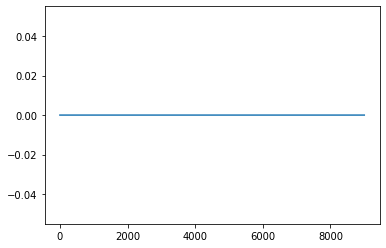

In [ ]:
rand = random.randint(0, len(X_seq))
plt.plot(X_seq[rand])
print(y_seq[rand])
print(y_seq_cen[rand])

In [ ]:
#@title **Splitting and prefetching**
%cd /content/drive/MyDrive/prove_DSNL_keras

Xtosplit, X_test, ytosplit, y_test = train_test_split(X, y, test_size=0.1, random_state=0)
X_train, X_valid, y_train, y_valid = train_test_split(Xtosplit, ytosplit, test_size=len(y_test), random_state=0)

del Xtosplit, ytosplit, X, y

AUTOTUNE = tf.data.experimental.AUTOTUNE
BATCH = 500
train = tf.data.Dataset.from_tensor_slices((X_train,y_train))
train = train.shuffle(1000).batch(BATCH).prefetch(AUTOTUNE)

valid = tf.data.Dataset.from_tensor_slices((X_valid,y_valid))
valid = valid.shuffle(1000).batch(BATCH).prefetch(AUTOTUNE)

test = tf.data.Dataset.from_tensor_slices((X_test,y_test))
test = valid.shuffle(1000).batch(BATCH).prefetch(AUTOTUNE)

/content/drive/MyDrive/prove_DSNL_keras


In [ ]:
#@title **Base model training**
%cd /content/drive/MyDrive/prove_DSNL_keras/
from train import *
from model_cnn import *


tf.keras.backend.clear_session()
tf.random.set_seed(42)
patience = 100
epochs = 5000
lr = 5.069551e-05

model = net1()
opt = tf.keras.optimizers.Adam(learning_rate=lr, epsilon= 1e-8)
model.compile(optimizer=opt,
                loss='categorical_crossentropy',
                metrics=['accuracy',
                          tfa.metrics.F1Score(num_classes=5,average='macro')
                         ])
class Metrics(tf.keras.callbacks.Callback):
    def __init__(self,validation_data,y_valid) -> None:
       self.validation_data = validation_data
       self.y_valid = y_valid

    def on_train_begin(self, logs={}):
        self._data = []

    def on_epoch_end(self, batch, logs={}):
        # x_test, y_test = self.validation_data[0], self.validation_data[1]
        y_predict = np.asarray(model.predict(self.validation_data))

        true = np.argmax(y_valid, axis=1)
        pred = np.argmax(y_predict, axis=1)
        
        cm = confusion_matrix(true, pred)
        cmf = cm.astype('float')
        # cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] 
        self._data.append({'cm':cm })

        print()
        print(cm.diagonal()/cm.sum(axis=1))
        print()
        print(np.around(cm, 2))
        print()
        # print(np.around(cm/np.sum(cm, axis=1),2))
        # print()
        return

    def get_data(self):
        return self._data

# metrics = Metrics(valid,y_valid) #with the prefetcher
metrics = Metrics(valid,y_valid)

log_dir = '/content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/'
log_directory = log_dir +'lr='+str(lr)+'_'+ datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard = tf.keras.callbacks.TensorBoard(log_dir=log_directory,
                                            histogram_freq=10,
                                            write_graph=True,
                                            write_grads=False,
                                            write_images=False,
                                            embeddings_freq=0,
                                            embeddings_layer_names=None,
                                            embeddings_metadata=None)

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                              min_delta=0.0001, 
                                              patience=patience,
                                              verbose=1,
                                              mode='min')

#if .h5 string is deleted at the end it will save in .model format                                                  
save_weights_at = log_dir +'models/'+ datetime.datetime.now().strftime("%Y_%m_%d-%H%M")+'.h5'

checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath=save_weights_at,
                                          monitor='val_loss',
                                          mode='min',
                                          verbose=1,
                                          save_best_only=True,
                                          save_weights_only=False)
    # prefetcher
history = model.fit(
                    train,
                    batch_size=500,
                    epochs=epochs,
                    verbose=1,
                    validation_data=valid,
                    callbacks=[tensorboard, early_stopping, checkpoint, metrics])

# history = model.fit(
#                     X_train,y_train,
#                     batch_size=250,
#                     epochs=epochs,
#                     verbose=1,
#                     validation_data=(X_valid, y_valid),
#                     callbacks=[tensorboard, early_stopping, checkpoint, metrics])



/content/drive/MyDrive/prove_DSNL_keras
Epoch 1/5000
  6/311 [..............................] - ETA: 53s - loss: 1.9827 - accuracy: 0.3423 - f1_score: 0.2306

311/311 [==============================] - ETA: 0s - loss: 1.2408 - accuracy: 0.5516 - f1_score: 0.4449
Epoch 1: val_loss improved from inf to 1.45823, saving model to /content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/models/2022_10_06-2202.h5

[0.13050719 0.09453878 0.68354616 0.07932692 0.01941748]

[[ 862  606 4455  524  158]
 [ 270  206 1486  170   47]
 [ 819  650 4657  516  171]
 [ 157  121  846   99   25]
 [ 316  255 1777  177   50]]

311/311 [==============================] - 64s 200ms/step - loss: 1.2408 - accuracy: 0.5516 - f1_score: 0.4449 - val_loss: 1.4582 - val_accuracy: 0.5231 - val_f1_score: 0.4065
Epoch 2/5000
311/311 [==============================] - ETA: 0s - loss: 0.7876 - accuracy: 0.7027 - f1_score: 0.5934
Epoch 2: val_loss did not improve from 1.45823

[0.07887964 0.07526388 0.71202114 0.06169872 0.07223301]

[[ 521  539 4679  433  433]
 [ 169  164 1565  142  139]
 [ 577  525 4851  429  431]
 [  97   92  886   77   96]
 [ 216  191 1823

In [ ]:
#@title **Test base_model**
base_model = tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/models/2022_10_06-2202.h5',
                                   custom_objects={'F1Score':tfa.metrics.F1Score(num_classes=5,average='macro')})
# y_test_pred = model.predict(X_test, batch_size=500)
# y_test_pred = model.predict_on_batch(X_test)
with tf.device("cpu:0"):
  y_test_pred = base_model.predict(X_test)
y_pred_df = pd.DataFrame(y_test_pred)
y_pred_df['y_cap'] = y_test_pred.argmax(axis=1)
y_pred_df['y'] = y_test.argmax(axis=1)

print(classification_report(np.argmax(y_test,axis=1), np.argmax(y_test_pred,axis=1)))

matrix = confusion_matrix(np.argmax(y_test,axis=1), np.argmax(y_test_pred,axis=1))
print(matrix.diagonal()/matrix.sum(axis=1))
print(matrix)

              precision    recall  f1-score   support

           0       0.88      0.93      0.91      6471
           1       0.43      0.47      0.45      2141
           2       0.88      0.83      0.85      6928
           3       0.83      0.85      0.84      1330
           4       0.81      0.76      0.78      2550

    accuracy                           0.82     19420
   macro avg       0.77      0.77      0.77     19420
weighted avg       0.82      0.82      0.82     19420

[0.93293154 0.46940682 0.82794457 0.8481203  0.75607843]
[[6037  301   56   20   57]
 [ 511 1005  447    7  171]
 [ 112  661 5736  200  219]
 [   1    3  197 1128    1]
 [ 171  344  106    1 1928]]


In [3]:
#@title **Creation and saving tcp labels for confidence training**
# model = tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/models/2022_10_06-2202.h5')
# import multiprocessing
# def prediction(model, X_train):
#   return model.predict(X_train)

# p = multiprocessing.Process(target=prediction(model, X_train))
# p.start()
# p.join()

# from keras import backend as K
# K.clear_session()
# from numba import cuda
# cuda.select_device(0)
# cuda.close()

base_model = tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/models/2022_10_06-2202.h5',
                                   custom_objects={'F1Score':tfa.metrics.F1Score(num_classes=5,average='macro')})

with tf.device("cpu:0"):
  y_train_pred = base_model.predict(X_train)
  y_valid_pred = base_model.predict(X_valid)
  y_test_pred = base_model.predict(X_test)

with open( 'datay_train_pred.npy', 'wb') as f:
  np.save(
      f,
      y_train_pred
  )
with open( 'datay_valid_pred.npy', 'wb') as f:
  np.save(
      f,
      y_valid_pred
  )
with open( 'datay_test_pred.npy', 'wb') as f:
  np.save(
      f,
      y_test_pred
  )

y_conf_train=[]
for i in range(len(y_train)):
  y_conf_train.append(y_train_pred[i][y_train[i].argmax(axis=0)])
y_conf_train = np.asarray(y_conf_train, dtype=np.float32)

y_conf_valid = []
for i in range(len(y_valid)):
  y_conf_valid.append(y_valid_pred[i][y_valid[i].argmax(axis=0)])
y_conf_valid = np.asarray(y_conf_valid, dtype=np.float32)
  
y_conf_test = []
for i in range(len(y_test)):
  y_conf_test.append(y_test_pred[i][y_test[i].argmax(axis=0)])
y_conf_test = np.asarray(y_conf_test, dtype=np.float32)

%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset

with open( 'datay_tcp_train.npy', 'wb') as f:
  np.save(
      f,
      y_conf_train
  )
with open( 'datay_tcp_valid.npy', 'wb') as f:
  np.save(
      f,
      y_conf_valid
  )
with open( 'datay_tcp_test.npy', 'wb') as f:
  np.save(
      f,
      y_conf_test
  )


607/607 [==============================] - 28s 46ms/step
/content/drive/MyDrive/prove_DSNL_keras/download_dataset


In [ ]:
#to do, downsampling, half downsampling, build the auxnet one layer at the time, adding more dropouts, using weigths

In [1]:
#@title **Google Drive mount + Libraries + GPU info + load X e y split**
from google.colab import drive
drive.mount('/content/drive')

%pip install mne==0.14 ## 0.20 in the github
%pip install tensorflow_addons

import os
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix #   p r e d
                                             # t
                                             # r
                                             # u
                                             # e
import datetime
import pickle
from os import listdir
from os.path import isfile, join
import tensorflow as tf
import random
import matplotlib.pyplot as plt
import tensorflow_addons as tfa
from matplotlib.ticker import PercentFormatter
import seaborn as sns
class_names = ["W","N1","N2","N3","REM"]

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)
del gpu, gpus

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

%tensorflow_version 2.x
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

%tensorflow_version 2.x
import tensorflow as tf
import timeit

device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  print(
      '\n\nThis error most likely means that this notebook is not '
      'configured to use a GPU.  Change this in Notebook Settings via the '
      'command palette (cmd/ctrl-shift-P) or the Edit menu.\n\n')
  raise SystemError('GPU device not found')

def cpu():
  with tf.device('/cpu:0'):
    random_image_cpu = tf.random.normal((100, 100, 100, 3))
    net_cpu = tf.keras.layers.Conv2D(32, 7)(random_image_cpu)
    return tf.math.reduce_sum(net_cpu)

def gpu():
  with tf.device('/device:GPU:0'):
    random_image_gpu = tf.random.normal((100, 100, 100, 3))
    net_gpu = tf.keras.layers.Conv2D(32, 7)(random_image_gpu)
    return tf.math.reduce_sum(net_gpu)
  
# We run each op once to warm up; see: https://stackoverflow.com/a/45067900
cpu()
gpu()

# Run the op several times.
print('Time (s) to convolve 32x7x7x3 filter over random 100x100x100x3 images '
      '(batch x height x width x channel). Sum of ten runs.')
print('CPU (s):')
cpu_time = timeit.timeit('cpu()', number=10, setup="from __main__ import cpu")
print(cpu_time)
print('GPU (s):')
gpu_time = timeit.timeit('gpu()', number=10, setup="from __main__ import gpu")
print(gpu_time)
print('GPU speedup over CPU: {}x'.format(int(cpu_time/gpu_time)))

# %tensorflow_version 2.x
# import tensorflow as tf
# print("Tensorflow version " + tf.__version__)

# try:
#   tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
#   print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
# except ValueError:
#   raise BaseException('ERROR: Not connected to a TPU runtime; please see the previous cell in this notebook for instructions!')

# tf.config.experimental_connect_to_cluster(tpu)
# tf.tpu.experimental.initialize_tpu_system(tpu)
# tpu_strategy = tf.distribute.experimental.TPUStrategy(tpu)
del cpu_time, gpu_time, gpu_info, ram_gb


class Metrics(tf.keras.callbacks.Callback):
    def __init__(self,validation_data,y_valid) -> None:
       self.validation_data = validation_data
       self.y_valid = y_valid

    def on_train_begin(self, logs={}):
        self._data = []

    def on_epoch_end(self, batch, logs={}):
        # x_test, y_test = self.validation_data[0], self.validation_data[1]
        y_predict = np.asarray(model.predict(self.validation_data))

        true = np.argmax(y_valid, axis=1)
        pred = np.argmax(y_predict, axis=1)
        
        cm = confusion_matrix(true, pred)
        cmf = cm.astype('float')
        # cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] 
        self._data.append({'cm':cm })

        print()
        print(cm.diagonal()/cm.sum(axis=1))
        print()
        print(np.around(cm, 2))
        print()
        # print(np.around(cm/np.sum(cm, axis=1),2))
        # print()
        return

    def get_data(self):
        return self._data

# metrics = Metrics(valid,y_valid) #with the prefetcher
# metrics = Metrics(valid,y_conf_valid)


%cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset/

with np.load('dataX_train.npz') as data:
  X_train = data['arr_0']
  y_train = data['arr_1']
with np.load('dataX_valid.npz') as data:
  X_valid = data['arr_0']
  y_valid = data['arr_1']
with np.load('dataX_test.npz') as data:
  X_test = data['arr_0']
  y_test = data['arr_1']

y_tcp_train = np.load('datay_tcp_train.npy')
y_tcp_valid = np.load('datay_tcp_valid.npy')
y_tcp_test = np.load('datay_tcp_test.npy')

y_train_pred = np.load('datay_train_pred.npy')
y_valid_pred = np.load('datay_valid_pred.npy')
y_test_pred = np.load('datay_test_pred.npy')

Mounted at /content/drive
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.7 MB 21.5 MB/s 
  Created wheel for mne: filename=mne-0.14-py3-none-any.whl size=5847172 sha256=850d839d743f0f2ca6164c073191dec442b8e93b084c33cbc37d072912318a42
  Stored in directory: /root/.cache/pip/wheels/23/35/90/d40695adfedcb7d358976a4222ff6ff317459781d406cc990e
Successfully built mne
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.1 MB 35.7 MB/s 
Mon Oct 17 13:40:35 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|

In [15]:
#@title **Functions for visualization**
def histogram_intersection(h1, h2, n_bins):
    return np.sum(np.minimum(h1,h2) * 1/n_bins)
  
def histMCP(correct: pd.DataFrame, uncorrect: pd.DataFrame, class_names: list):
  #function to plot the histogram of the correct and uncorrect results of Maximum
  # Class Probability MCP
  histMCP_c=[]
  histMCP_u=[]
  n_bins=20
  #correct for class
  fig1 = plt.figure(figsize=(20,8))
  fig1.suptitle('Correct classification MCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = correct.loc[correct["y"]==i] #select the correct from class i
    data = tmp.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)
    hist, _, _ = plt.hist(data,
             weights= np.ones(len(data))/len(data), # weighting the data like 1/n 
                                                    # with n total number of datapoints to get the percentage
             bins=n_bins)
    
    histMCP_c.append(hist)
    plt.title(f"Class {name}")
    plt.gca().set_xlim(0,1)
    plt.gca().set_ylim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
  
  #uncorrect for class
  fig2 = plt.figure(figsize=(20,8))
  fig2.suptitle('Uncorrect classification MCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = uncorrect.loc[uncorrect["y"]==i] #select the uncorrect from class i
    tmp = tmp.iloc[:,:-2] #exclude last two columns with y_cap and y
    tmp["max"] = tmp.max(axis=1) #create a column with max element of the row
    data = tmp.iloc[:,-1].to_numpy()
    
    plt.subplot(2,5,i+1)
    hist, _, _ = plt.hist(data, 
            weights= np.ones(len(data))/len(data), # weighting the data like 1/n
            bins=n_bins)
    
    histMCP_u.append(hist)
    plt.title(f"Class {name}")
    plt.gca().set_xlim(0,1)
    plt.gca().set_ylim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))

  #mixed for class
  fig3 = plt.figure(figsize=(20,8))
  fig3.suptitle('Correct vs Uncorrect classification MCP', fontsize=20)
  for i,name in enumerate(class_names):

    tmpu = uncorrect.loc[uncorrect["y"]==i] #see before
    tmpu = tmpu.iloc[:,:-2]
    tmpu["max"] = tmpu.max(axis=1)
    datau = tmpu.iloc[:,-1].to_numpy()

    tmpc = correct.loc[correct["y"]==i] #see before
    datac = tmpc.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)
    histu, _, _ = plt.hist(datau,
             weights= np.ones(len(datau))/len(datau), 
             bins=n_bins, alpha=0.8, color='red', label='uncorrect')
    histc, _, _ = plt.hist(datac,
             weights= np.ones(len(datac))/len(datac), 
             bins=n_bins, alpha=0.8, color='green', label='correct')
    plt.title(f"Class {name}")
    plt.gca().set_xlim(0,1)
    plt.gca().set_ylim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
    plt.legend(loc=2)
  
    intersection = histogram_intersection(histc,histu,n_bins)
    plt.annotate(f'intersection: {intersection:.2}',xy=(0.05, 0.45))
  
  #total (not for class)
  fig4 = plt.figure(figsize=(20,8))
  fig4.suptitle('Hist MCP', fontsize=20)
  
  plt.subplot(1,3,1)
  data1 = correct.iloc[:,:-2] #see before
  data1["max"] = data1.max(axis=1) 
  plt.hist(data1['max'],
             weights= np.ones(len(data1))/len(data1), # weighting the data like 1/n
             bins=n_bins, color='green')
  plt.title(f'Hist Correct MCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))


  plt.subplot(1,3,2)
  data2 = uncorrect.iloc[:,:-2] #see before
  data2["max"] = data2.max(axis=1) 
  plt.hist(data2['max'],
             weights= np.ones(len(data2))/len(data2),  # weighting the data like 1/n
             bins=n_bins, color='red')
  plt.title(f'Hist Uncorrect MCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))


  plt.subplot(1,3,3)
  histMCP_total_c, _, _ = plt.hist(data1['max'],
             weights= np.ones(len(data1))/len(data1), 
             bins=n_bins, alpha=0.8, color='green', label='correct')
  histMCP_total_u, _, _ = plt.hist(data2['max'],
             weights= np.ones(len(data2))/len(data2), 
             bins=n_bins, alpha=0.8, color='red', label='uncorrect')
  
  plt.title(f'Hist Correct vs Uncorrect MCP')
  intersection = histogram_intersection(histMCP_total_c,histMCP_total_u,n_bins)
  plt.annotate(f'intersection: {intersection:.2}', xy=(0.05,0.8))

  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
  plt.legend(loc=2)


  return (histMCP_c, histMCP_u, histMCP_total_c, histMCP_total_u)

def kdeMCP(correct: pd.DataFrame, uncorrect: pd.DataFrame, class_names: list):
  #for more serious implementation
  #https://gist.github.com/FlorianHeinrichs/74dd21d0d1abf5293946a727e6dd3f5c#file-kde1-py
  #https://gist.github.com/FlorianHeinrichs/bcbb2093ccacc7e7b1f5db46dc4753c8#file-kde2-py
  #TODO is possible to have y axis in percentage? deep into kde ... for now is a density plot
  # so the auc is 1, maybe is not necessary to have the y in percentage if we can compute the percentage
  # of overlapping area

  fig1 = plt.figure(figsize=(20,8))
  fig1.suptitle('Classification MCP', fontsize=20)
  #take one class at the time ["y"]==i and plot the confidence, ergo
  # the max output of the softmax 
  for i,name in enumerate(class_names):
    
    tmpu = uncorrect.loc[uncorrect["y"]==i] #temp for uncorrect pred
    tmpc = correct.loc[correct["y"]==i]  #temp for correct pred
    tmpu = tmpu.iloc[:,:-2]
    #find the max for each row, for the correct ones is simpler because the max
    # prediction is in the column of the corrispondent class, here in the uncorrect
    # one the prediction can be in any column
    tmpu["max"] = tmpu.max(axis=1)
    datau = tmpu.iloc[:,-1].to_numpy()
    datac = tmpc.iloc[:,i].to_numpy()

    # plt.subplot(2,5,i+1)
    # #kde plot, default with guassian kernel
    # ax1 = sns.kdeplot(datau, clip=(0,1),fill=True, alpha=.5,color='red', label='uncorrect',legend=True)
    # ax2 = sns.kdeplot(datac, clip=(0,1),fill=True, alpha=.5, color='green', label='correct', legend=True)
    # plt.title(f"Class {name}")
    # plt.gca().set_xlim(0,1)
    # plt.gca().set_xlabel("Confidence")
    
    # plt.legend()

  #total, not for class
  # fig2 = plt.figure(figsize=(20,8))
  # fig2.suptitle('Kernel Density Estimation MCP', fontsize=20)
  
  # plt.subplot(1,3,1)
  data1 = correct.iloc[:,:-2]
  data1["max"] = data1.max(axis=1)

  # sns.kdeplot(data1['max'], clip=(0,1),fill=True,color='green',label='correct')
  # plt.title(f'KDE Correct TCP')
  # plt.gca().set_xlim(0,1)
  # plt.gca().set_xlabel("Confidence")

  # plt.subplot(1,3,2)
  data2 = uncorrect.iloc[:,:-2]
  data2["max"] = data2.max(axis=1)
  # sns.kdeplot(data2["max"], clip=(0,1),fill=True, color='red',label='uncorrect')

  # plt.subplot(1,3,3)
  #kde plot, default with guassian kernel
  ax1 = sns.kdeplot(data2['max'], clip=(0,1),fill=True, alpha=.5,color='red', label='uncorrect',legend=True)
  ax2 = sns.kdeplot(data1['max'], clip=(0,1),fill=True, alpha=.5, color='green', label='correct', legend=True)

  plt.title(f'KDE Correct vs Uncorrect MCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.legend()


def ecdfMCP(correct: pd.DataFrame, uncorrect: pd.DataFrame, class_names: list):
  #correct for class
  fig1 = plt.figure(figsize=(20,8))
  fig1.suptitle('ECDF Correct classification MCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = correct.loc[correct["y"]==i]
    data = tmp.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)
    # x = np.sort(data)
    # y = np.arange(len(data))/float(len(data))
    # plt.plot(x,y)
    sns.ecdfplot(data, color='green')
    plt.title(f"Class {name}")
    plt.gca().set_xlabel("Confidence")
    
  #uncorrect for class
  fig2 = plt.figure(figsize=(18,8))
  fig2.suptitle('ECDF Uncorrect classification MCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = uncorrect.loc[uncorrect["y"]==i]
    tmp = tmp.iloc[:,:-2]
    tmp["max"] = tmp.max(axis=1)
    data = tmp.iloc[:,-1].to_numpy()
    
    plt.subplot(2,5,i+1)
    sns.ecdfplot(data, color='red')
    plt.title(f"Class {name}")
    plt.gca().set_xlabel("Confidence")
  
  #mixed for class
  fig3 = plt.figure(figsize=(20,8))
  fig3.suptitle('ECDF Correct vs Uncorrect classification MCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmpu = uncorrect.loc[uncorrect["y"]==i]
    tmpu = tmpu.iloc[:,:-2]
    tmpu["max"] = tmpu.max(axis=1)
    datau = tmpu.iloc[:,-1].to_numpy()

    tmpc = correct.loc[correct["y"]==i]
    datac = tmpc.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)
    sns.ecdfplot(datau, label ='uncorrect', color='red')
    sns.ecdfplot(datac, label = 'correct', color='green')
    plt.title(f"Class {name}")
    plt.gca().set_xlabel("Confidence")
    plt.legend()

  
  #total (not for class)
  fig4 = plt.figure(figsize=(20,8))
  fig4.suptitle('ECDF MCP', fontsize=20)
  
  plt.subplot(1,3,1)
  data1 = correct.iloc[:,:-2]
  data1["max"] = data1.max(axis=1)
  sns.ecdfplot(data1["max"], color='green')
  plt.title(f'ECDF Correct MCP')

  plt.subplot(1,3,2)
  data2 = uncorrect.iloc[:,:-2]
  data2["max"] = data2.max(axis=1)
  sns.ecdfplot(data2['max'], color='red')
  plt.title(f'ECDF Uncorrect MCP')

  plt.subplot(1,3,3)
  sns.ecdfplot(data1['max'], color='green', label='correct')
  sns.ecdfplot(data2['max'], color='red', label='uncorrect')
  plt.title(f'ECDF Correct vs Uncorrect MCP')
  plt.gca().set_xlabel("Confidence")
  plt.legend()

def histTCP(conf_correct: pd.DataFrame, conf_uncorrect: pd.DataFrame, 
            class_names: list):
  n_bins=20
  #correct
  fig1 = plt.figure(figsize=(20,8))
  fig1.suptitle('Correct classification TCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = conf_correct.loc[conf_correct["y"]==i] #select the correct from class i
    data01 = tmp.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)
    plt.hist(data01, 
             weights= np.ones(len(data01))/len(data01), # weighting the data like 1/n
             bins=n_bins)
    
    plt.title(f"Class {name}")
    plt.gca().set_xlim(0,1)
    plt.gca().set_ylim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))

  #uncorrect
  #TODO why in the graphs this part has very little bins? idk
  fig2 = plt.figure(figsize=(20,8))
  fig2.suptitle('Uncorrect classification TCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = conf_uncorrect.loc[conf_uncorrect["y"]==i] #select the correct from class i
    data02 = tmp.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)
    plt.hist(data02, range=(0,1),
             weights= np.ones(len(data02))/len(data02), # weighting the data like 1/n
             bins=n_bins)
    
    plt.title(f"Class {name}")
    plt.gca().set_xlim(0,1)
    plt.gca().set_ylim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
    
  #mixed
  fig3 = plt.figure(figsize=(20,8))
  fig3.suptitle('Correct vs Uncorrect classification TCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmpu = conf_uncorrect.loc[conf_uncorrect["y"]==i] #see before
    datau = tmpu.iloc[:,i].to_numpy()

    tmpc = conf_correct.loc[conf_correct["y"]==i] #see before
    datac = tmpc.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)
    histu, _, _ = plt.hist(datau, range=(0,1),
             weights= np.ones(len(datau))/len(datau), 
             bins=n_bins, alpha=0.8, color='red', label='uncorrect')
    histc, _, _ = plt.hist(datac,
             weights= np.ones(len(datac))/len(datac), 
             bins=n_bins, alpha=0.8, color='green', label='correct')
    plt.title(f"Class {name}")
    intersection = histogram_intersection(histc,histu,n_bins)
    plt.annotate(f'intersection: {intersection:.2}',xy=(0.1, 0.65))

    plt.gca().set_xlim(0,1)
    plt.gca().set_ylim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
    plt.legend(loc='upper center')
  
  #total (not for class)
  fig4 = plt.figure(figsize=(20,8))
  fig4.suptitle('Hist TCP', fontsize=20)
  
  plt.subplot(1,3,1)
  data1=[]
  for i,row in enumerate(conf_correct.values):
    data1.append(row[conf_correct.iloc[i,-2]])
   #scrolling the rows, on every i-th row, I select the column correspondent to the
  # prediction done (y_cap), ie in the first row the y_cap is 5 so I select the 5th
  # element of the row

  plt.hist(data1,
             weights= np.ones(len(data1))/len(data1), # weighting the data like 1/n
             bins=n_bins, color='green')
  plt.title(f'Hist Correct TCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))


  plt.subplot(1,3,2)
  data2=[]
  for i,row in enumerate(conf_uncorrect.values):
    data2.append(row[conf_uncorrect.iloc[i,-2]])
  #see before

  plt.hist(data2,
             weights= np.ones(len(data2))/len(data2), # weighting the data like 1/n
             bins=n_bins, color='red')
  plt.title(f'Hist Uncorrect TCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))


  plt.subplot(1,3,3)
  histc, _, _ = plt.hist(data1,
             weights= np.ones(len(data1))/len(data1), 
             bins=n_bins, alpha=0.8, color='green', label='correct')
  histu, _, _ = plt.hist(data2,
             weights= np.ones(len(data2))/len(data2), 
             bins=n_bins, alpha=0.8, color='red', label='uncorrect')
  intersection = histogram_intersection(histc,histu,n_bins)
  plt.annotate(f'intersection: {intersection:.2}',xy=(0.2, 0.4))

  plt.title(f'Hist Correct vs Uncorrect TCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
  plt.legend()


def kdeTCP(conf_correct: pd.DataFrame, conf_uncorrect: pd.DataFrame, 
           class_names: list):
  fig1 = plt.figure(figsize=(20,8))
  fig1.suptitle('Classification TCP', fontsize=20)
  for i,name in enumerate(class_names):
    #temp for uncorrect pred
    conf_tmpu = conf_uncorrect.loc[conf_uncorrect["y"]==i]
    #temp for correct pred
    conf_tmpc = conf_correct.loc[conf_correct["y"]==i]
    plt.subplot(2,5,i+1)
    #kde plot, default with guassian kernel
    ax1 = sns.kdeplot(conf_tmpu.iloc[:,i].to_numpy(), clip=(0,1),fill=True, alpha=.5,color='red',label='uncorrect', legend=True)
    ax2 = sns.kdeplot(conf_tmpc.iloc[:,i].to_numpy(), clip=(0,1),fill=True, alpha=.5, color='green', label='correct', legend=True)
    plt.title(f"Class {name}")
    plt.gca().set_xlim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.legend()

  #total (not for class)
  fig2 = plt.figure(figsize=(18,8))
  fig2.suptitle('Kernel Density Estimation TCP', fontsize=20)
  
  plt.subplot(1,3,1)
  data1=[]
  for i,row in enumerate(conf_correct.values):
    data1.append(row[conf_correct.iloc[i,-2]])
   #scrolling the rows, on every i-th row, I select the column correspondent to the
  # prediction done (y_cap), ie in the first row the y_cap is 5 so I select the 5th
  # element of the row

  sns.kdeplot(data1, clip=(0,1),fill=True,color='green',label='correct')
  plt.title(f'KDE Correct TCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_xlabel("Confidence")

  plt.subplot(1,3,2)
  data2=[]
  for i,row in enumerate(conf_uncorrect.values):
    data2.append(row[conf_uncorrect.iloc[i,-2]])  #see before

  sns.kdeplot(data2, clip=(0,1),fill=True, color='red',label='uncorrect')
  plt.title(f'KDE Uncorrect TCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_xlabel("Confidence")
  
  plt.subplot(1,3,3)
  sns.kdeplot(data1, clip=(0,1),fill=True,alpha=.5,color='green',label='correct', legend=True)
  sns.kdeplot(data2, clip=(0,1),fill=True,alpha=.5, color='red',label='uncorrect', legend=True)
  
  plt.title(f'KDE Correct vs Uncorrect TCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.legend()

def ecdfTCP(conf_correct: pd.DataFrame, conf_uncorrect: pd.DataFrame, 
            class_names: list):
  #correct for class
  fig1 = plt.figure(figsize=(20,8))
  fig1.suptitle('ECDF Correct classification TCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = conf_correct.loc[conf_correct["y"]==i]
    data = tmp.iloc[:,i].to_numpy()
    plt.subplot(2,5,i+1)
    sns.ecdfplot(data, color='green')
    plt.title(f"Class {name}")

  #uncorrect for class
  fig2 = plt.figure(figsize=(20,8))
  fig2.suptitle('ECDF Uncorrect classification TCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = conf_uncorrect.loc[conf_uncorrect["y"]==i]
    data = tmp.iloc[:,i].to_numpy()
    plt.subplot(2,5,i+1)
    sns.ecdfplot(data, color='red')
    plt.title(f"Class {name}")
    
  #mixed for class
  fig3 = plt.figure(figsize=(20,8))
  fig3.suptitle('ECDF Correct vs Uncorrect classification TCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmpu = conf_uncorrect.loc[conf_uncorrect["y"]==i]
    datau = tmpu.iloc[:,i].to_numpy()

    tmpc = conf_correct.loc[conf_correct["y"]==i]
    datac = tmpc.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)

    sns.ecdfplot(datau, color='red', label ='uncorrect')
    sns.ecdfplot(datac, color='green', label = 'correct')
    plt.title(f"Class {name}")
    plt.legend()

  #correct total
  fig4 = plt.figure(figsize=(20,8))
  fig4.suptitle('ECDF TCP', fontsize=20)
  plt.subplot(1,3,1)
  data1=[]
  for i,row in enumerate(conf_correct.values): #see before
    data1.append(row[conf_correct.iloc[i,-2]])
  
  sns.ecdfplot(data1, color='green')
  plt.title(f'ECDF Correct TCP')

  plt.subplot(1,3,2)
  data2=[]
  for i,row in enumerate(conf_uncorrect.values):
    data2.append(row[conf_uncorrect.iloc[i,-2]])  #see before

  sns.ecdfplot(data2, color='red')
  plt.title(f'ECDF Uncorrect TCP')

  plt.subplot(1,3,3)
  sns.ecdfplot(data1, color='green',  label='correct')
  sns.ecdfplot(data2, color='red',  label='uncorrect')
  plt.title(f'ECDF Correct vs Uncorrect TCP')
  plt.legend()

#plots comparisons

def ecdfcompare(correct: pd.DataFrame, uncorrect: pd.DataFrame, 
                conf_correct: pd.DataFrame, conf_uncorrect: pd.DataFrame, 
                class_names: list):
  #correct vs correct for class
  fig1 = plt.figure(figsize=(20,8))
  fig1.suptitle('ECDF Correct classification MCP vs TCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmpc1 = correct.loc[correct["y"]==i]
    data1 = tmpc1.iloc[:,i].to_numpy()

    tmpc2 = conf_correct.loc[conf_correct["y"]==i]
    data2 = tmpc2.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)
    sns.ecdfplot(data1, label='MCP')
    sns.ecdfplot(data2, label='TCP')
    plt.title(f"Class {name}")
    plt.legend()

  #correct vs uncorrect for class
  fig2 = plt.figure(figsize=(20,8))
  fig2.suptitle('ECDF Uncorrect classification MCP vs TCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmpu1 = uncorrect.loc[uncorrect["y"]==i]
    tmpu1 = tmpu1.iloc[:,:-2]
    tmpu1["max"] = tmpu1.max(axis=1)
    data1 = tmpu1.iloc[:,-1].to_numpy()
    
    tmpu2 = conf_uncorrect.loc[conf_uncorrect["y"]==i]
    data2 = tmpu2.iloc[:,i].to_numpy()

    plt.subplot(2,5,i+1)
    sns.ecdfplot(data1, label='MCP')
    sns.ecdfplot(data2, label='TCP')
    plt.title(f"Class {name}")
    plt.legend()

#correct total
  fig3 = plt.figure(figsize=(20,8))
  fig3.suptitle('ECDF MCP vs TCP', fontsize=20)
  plt.subplot(1,3,1)
  #correct MCP
  data1 = correct.iloc[:,:-2]
  data1["max"] = data1.max(axis=1)
  sns.ecdfplot(data1['max'], label='MCP')
  #correct TCP
  data11=[]
  for i,row in enumerate(conf_correct.values): #see before
    data11.append(row[conf_correct.iloc[i,-2]])
  sns.ecdfplot(data11, label='TCP')
  plt.title(f'ECDF Correct MCP vs TCP')
  plt.legend()

  plt.subplot(1,3,2)
  #uncorrect MCP
  data2 = uncorrect.iloc[:,:-2]
  data2["max"] = data2.max(axis=1)
  sns.ecdfplot(data2['max'], label='MCP')
  #uncorrect TCP
  data22=[]
  for i,row in enumerate(conf_uncorrect.values):
    data22.append(row[conf_uncorrect.iloc[i,-2]])  #see before
  sns.ecdfplot(data22, label='TCP')
  plt.title(f'ECDF Uncorrect MCP vs TCP')
  plt.legend()

  plt.subplot(1,3,3)
  sns.ecdfplot(data1['max'], color='limegreen', label='correct MCP')
  sns.ecdfplot(data11, color='darkgreen', label='correct TCP')
  sns.ecdfplot(data2['max'], color='lightcoral', label='uncorrect MCP')
  sns.ecdfplot(data22, color='darkred', label='uncorrect TCP')
  
  plt.title(f'ECDF Correct vs Uncorrect MCP vs TCP')
  plt.legend()


def histcompare(correct: pd.DataFrame, uncorrect: pd.DataFrame, 
                conf_correct: pd.DataFrame, conf_uncorrect: pd.DataFrame,
                class_names:list):
  n_bins = 20
  data1 = correct.iloc[:,:-2] #see before
  data1["max"] = data1.max(axis=1) 
  
  data2 = uncorrect.iloc[:,:-2] #see before
  data2["max"] = data2.max(axis=1) 

  data1c=[]
  for i,row in enumerate(conf_correct.values):
    data1c.append(row[conf_correct.iloc[i,-2]])
   #scrolling the rows, on every i-th row, I select the column correspondent to the
  # prediction done (y_cap), ie in the first row the y_cap is 5 so I select the 5th
  # element of the row

  data2c=[]
  for i,row in enumerate(conf_uncorrect.values):
    data2c.append(row[conf_uncorrect.iloc[i,-2]]) #see before
  
  
  fig1 = plt.figure(figsize=(20,8))
  fig1.suptitle('Hist MCP vs TCP', fontsize=20)
  # plt.subplot(121)
  

  histMCP_total_c, _, _ = plt.hist(data1['max'], range=(0,1),
             weights= np.ones(len(data1))/len(data1), 
             bins=n_bins, alpha=0.8, color='green', label='MCP correct')
  histMCP_total_u, _, _ = plt.hist(data2['max'], range=(0,1),
             weights= np.ones(len(data2))/len(data2), 
             bins=n_bins, alpha=0.8, color='red', label='MCP uncorrect')
  
  histTCP_total_c, _, _ = plt.hist(data1c, range=(0,1),
             weights= np.ones(len(data1c))/len(data1c), 
             bins=n_bins, alpha=0.8, color='green', label='TCP correct')
  histTCP_total_u, _, _ = plt.hist(data2c, range=(0,1),
             weights= np.ones(len(data2c))/len(data2c), 
             bins=n_bins, alpha=0.8, color='red', label='TCP uncorrect')
  
  overlapMCP = np.minimum(histMCP_total_c,histMCP_total_u)
  overlapTCP = np.minimum(histTCP_total_c,histTCP_total_u)
  x_axis = np.linspace(0,1,n_bins)

  plt.plot(x_axis, overlapMCP,color='orange', label='overlap MCP')
  plt.plot(x_axis, overlapTCP,color='navy', label='overlap TCP')

  plt.title(f'Hist Correct vs Uncorrect MCP vs TCP')

  intersectionMCP = histogram_intersection(histMCP_total_c,histMCP_total_u, n_bins)
  plt.annotate(f'intersectionMCP: {intersectionMCP:.2}', xy=(0.15,0.95))
  intersectionTCP = histogram_intersection(histTCP_total_c,histTCP_total_u, n_bins)
  plt.annotate(f'intersectionTCP: {intersectionTCP:.2}', xy=(0.15,0.85))

  # plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  # plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
  plt.legend(loc=2)

  fig2 = plt.figure(figsize=(20,8))
  fig2.suptitle('Hist MCP vs TCP', fontsize=20)
  # plt.subplot(121)
  
  histMCP_total_c, _, _ = plt.hist(data1['max'], range=(0,1),
             weights= np.ones(len(data1))/len(data1), 
             bins=n_bins, alpha=0.8, color='green', label='MCP correct')
  histMCP_total_u, _, _ = plt.hist(data2['max'], range=(0,1),
             weights= np.ones(len(data2))/len(data2), 
             bins=n_bins, alpha=0.8, color='red', label='MCP uncorrect')
  
  histTCP_total_c, _, _ = plt.hist(data1c, range=(0,1),
             weights= np.ones(len(data1c))/len(data1c), 
             bins=n_bins, alpha=0.8, color='green', label='TCP correct')
  histTCP_total_u, _, _ = plt.hist(data2c, range=(0,1),
             weights= np.ones(len(data2c))/len(data2c), 
             bins=n_bins, alpha=0.8, color='red', label='TCP uncorrect')
  
  overlapMCP = np.minimum(histMCP_total_c,histMCP_total_u)
  overlapTCP = np.minimum(histTCP_total_c,histTCP_total_u)
  x_axis = np.linspace(0,1,n_bins)

  plt.plot(x_axis, overlapMCP,color='orange', label='overlap MCP',lw=2.)
  plt.plot(x_axis, overlapTCP,color='navy', label='overlap TCP',lw=2.)

  plt.title(f'Hist Correct vs Uncorrect MCP vs TCP')

  intersectionMCP = histogram_intersection(histMCP_total_c,histMCP_total_u, n_bins)
  plt.annotate(f'intersectionMCP: {intersectionMCP:.2}', xy=(0.15,0.95))
  intersectionTCP = histogram_intersection(histTCP_total_c,histTCP_total_u, n_bins)
  plt.annotate(f'intersectionTCP: {intersectionTCP:.2}', xy=(0.15,0.85))

  # plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,0.28)
  plt.gca().set_xlabel("Confidence")
  # plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
  plt.legend(loc=2)

  # fig2 = plt.figure(figsize=(10,8))
  # fig2.suptitle('Hist MCP vs TCP', fontsize=20)
  # plt.subplot(122)
  # sns.histplot(data1['max'], color='green', bins=n_bins, 
  #              binrange=(0,1), stat='probability', multiple='stack',
  #              element='step')
  # sns.histplot(data2['max'], color='red', bins=n_bins, 
  #              binrange=(0,1), stat='probability', multiple='stack',
  #               element='step')
  
  # sns.histplot(data1c, color='green', bins=n_bins, 
  #              binrange=(0,1), stat='probability', multiple='stack',
  #              element='step')
  # sns.histplot(data2c, color='red', bins=n_bins, 
  #              binrange=(0,1), stat='probability', multiple='stack',
  #              element='step')
  
  fig3 = plt.figure(figsize=(20,8))
  fig3.suptitle('Overlapping MCP vs TCP', fontsize=20)

  # plt.subplot(223)
  overlapMCP = np.minimum(histMCP_total_c,histMCP_total_u)
  overlapTCP = np.minimum(histTCP_total_c,histTCP_total_u)

  x_axis = np.linspace(0,1,n_bins)

  sns.lineplot(data=overlapMCP, color='red', label='MCP')
  sns.lineplot(data=overlapTCP, color='green', label='TCP')
  
  plt.title(f'Hist Correct vs Uncorrect MCP vs TCP')

  # intersectionMCP = histogram_intersection(histMCP_total_c,histMCP_total_u, n_bins)
  # plt.annotate(f'intersectionMCP: {intersectionMCP:.2}', xy=(0.05,0.8))
  # intersectionTCP = histogram_intersection(histTCP_total_c,histTCP_total_u, n_bins)
  # plt.annotate(f'intersectionTCP: {intersectionTCP:.2}', xy=(0.05,0.7))

  # # plt.gca().set_xlim(0,1)
  # # plt.gca().set_ylim(0,1)
  # plt.gca().set_xlabel("Confidence")
  # # plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
  # plt.legend(loc=2)

  # print(np.minimum(histMCP_total_c,histMCP_total_u))
def histTCP_pred(conf_correct: pd.DataFrame, conf_uncorrect: pd.DataFrame, 
            class_names: list):
  n_bins=20
  #correct
  fig1 = plt.figure(figsize=(20,8))
  fig1.suptitle('Correct classification TCP pred', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = conf_correct.loc[conf_correct["y"]==i] #select the correct from class i
    data01 = tmp.iloc[:,-1].to_numpy()

    plt.subplot(2,5,i+1)
    plt.hist(data01, 
              weights= np.ones(len(data01))/len(data01), # weighting the data like 1/n
              bins=n_bins)
    
    plt.title(f"Class {name}")
    plt.gca().set_xlim(0,1)
    plt.gca().set_ylim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))

  #uncorrect
  #TODO why in the graphs this part has very little bins? idk
  fig2 = plt.figure(figsize=(20,8))
  fig2.suptitle('Uncorrect classification TCP predicted', fontsize=20)
  for i,name in enumerate(class_names):
    tmp = conf_uncorrect.loc[conf_uncorrect["y"]==i] #select the correct from class i
    data02 = tmp.iloc[:,-1].to_numpy()

    plt.subplot(2,5,i+1)
    plt.hist(data02, range=(0,1),
              weights= np.ones(len(data02))/len(data02), # weighting the data like 1/n
              bins=n_bins)
    
    plt.title(f"Class {name}")
    plt.gca().set_xlim(0,1)
    plt.gca().set_ylim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
    
  #mixed
  fig3 = plt.figure(figsize=(20,8))
  fig3.suptitle('Correct vs Uncorrect classification TCP', fontsize=20)
  for i,name in enumerate(class_names):
    tmpu = conf_uncorrect.loc[conf_uncorrect["y"]==i] #see before
    datau = tmpu.iloc[:,-1].to_numpy()

    tmpc = conf_correct.loc[conf_correct["y"]==i] #see before
    datac = tmpc.iloc[:,-1].to_numpy()

    plt.subplot(2,5,i+1)
    histu, _, _ = plt.hist(datau, range=(0,1),
              weights= np.ones(len(datau))/len(datau), 
              bins=n_bins, alpha=0.8, color='red', label='uncorrect')
    histc, _, _ = plt.hist(datac,
              weights= np.ones(len(datac))/len(datac), 
              bins=n_bins, alpha=0.8, color='green', label='correct')
    plt.title(f"Class {name}")
    intersection = histogram_intersection(histc,histu,n_bins)
    plt.annotate(f'intersection: {intersection:.2}',xy=(0.1, 0.65))

    plt.gca().set_xlim(0,1)
    plt.gca().set_ylim(0,1)
    plt.gca().set_xlabel("Confidence")
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
    plt.legend(loc='upper center')

  #total (not for class)
  fig4 = plt.figure(figsize=(20,8))
  fig4.suptitle('Hist TCP', fontsize=20)

  plt.subplot(1,3,1)
  data1=[]
  for i,row in enumerate(conf_correct.values):
    data1.append(conf_correct.iloc[i,-1])
    #scrolling the rows, on every i-th row, I select the column correspondent to the
  # prediction done (y_cap), ie in the first row the y_cap is 5 so I select the 5th
  # element of the row

  plt.hist(data1,
              weights= np.ones(len(data1))/len(data1), # weighting the data like 1/n
              bins=n_bins, color='green')
  plt.title(f'Hist Correct TCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))


  plt.subplot(1,3,2)
  data2=[]
  for i,row in enumerate(conf_uncorrect.values):
    data2.append(conf_uncorrect.iloc[i,-1])
  #see before

  plt.hist(data2,
              weights= np.ones(len(data2))/len(data2), # weighting the data like 1/n
              bins=n_bins, color='red')
  plt.title(f'Hist Uncorrect TCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))


  plt.subplot(1,3,3)
  histc, _, _ = plt.hist(data1,
              weights= np.ones(len(data1))/len(data1), 
              bins=n_bins, alpha=0.8, color='green', label='correct')
  histu, _, _ = plt.hist(data2,
              weights= np.ones(len(data2))/len(data2), 
              bins=n_bins, alpha=0.8, color='red', label='uncorrect')
  intersection = histogram_intersection(histc,histu,n_bins)
  plt.annotate(f'intersection: {intersection:.2}',xy=(0.2, 0.4))

  plt.title(f'Hist Correct vs Uncorrect TCP')
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
  plt.legend()

#TODO custom metrics
# ap success
# accuracy success
# ap errors
# accuracy errors
# fpr at 95 tpr
# mean iou
# aurc
# https://github.com/valeoai/ConfidNet/blob/master/confidnet/utils/metrics.py



In [ ]:
#test with tensorflow datasets without interleave, works fine
AUTOTUNE = tf.data.experimental.AUTOTUNE
BATCH = 500
train = tf.data.Dataset.from_tensor_slices((X_train,y_conf_train))
train = train.shuffle(1000).batch(BATCH).prefetch(AUTOTUNE)

valid = tf.data.Dataset.from_tensor_slices((X_valid,y_conf_valid))
valid = valid.shuffle(1000).batch(BATCH).prefetch(AUTOTUNE)

NameError: ignored

In [8]:
%cd /content/drive/MyDrive/prove_DSNL_keras/
from train import *
# from model_cnn import *
from sklearn.metrics import confusion_matrix #   p r e d
                                             # t
                                             # r
                                             # u
                                             # e

from tensorflow import keras
from keras.models import Model
from keras.layers import Input, Conv1D, Dense, Dropout, MaxPool1D, Activation
from keras.layers import Reshape, BatchNormalization

tf.keras.backend.clear_session()
tf.random.set_seed(42)
patience = 30
epochs = 100
# lr = 5.069551e-07 #optimal lr for base_model
lr = 1e-03

base_model = tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/models/2022_10_06-2202.h5',
                                   custom_objects={'F1Score':tfa.metrics.F1Score(num_classes=5,average='macro')})

def aux_net():
  mom = 0.9
  activation = tf.nn.relu
  # activation = tf.nn.leaky_relu
  padding = 'same'

  ######### Input ########
  input_signal = Input(shape=(9000,1), name='input_signal')
  # print("input_signal:",input_signal.shape)

  ######### CNNs with small filter size at the first layer #########

  cnn0 = Conv1D(
    kernel_size=50,
    filters=64,
    strides=6,
    kernel_regularizer=keras.regularizers.l2(0.001),
    bias_regularizer=keras.regularizers.l2(0.001)) 
  s = cnn0(input_signal)
  s = BatchNormalization(momentum=mom, epsilon=0.00001)(s) 
  s = Activation(activation=activation)(s)

  cnn1 = MaxPool1D(pool_size=8, strides=8)
  s = cnn1(s)

  cnn2 = Dropout(0.5)
  s = cnn2(s)

  cnn3 = Conv1D(kernel_size=8,filters=128,strides=1,padding=padding)
  s = cnn3(s)
  s = BatchNormalization(momentum=mom, epsilon=0.00001)(s)
  s = Activation(activation=activation)(s)

  cnn4 = Conv1D(kernel_size=8,filters=128,strides=1,padding=padding)
  s = cnn4(s)
  s = BatchNormalization(momentum=mom, epsilon=0.00001)(s)
  s = Activation(activation=activation)(s)

  cnn5 = Conv1D(kernel_size=8,filters=128,strides=1,padding=padding)
  s = cnn5(s)
  s = BatchNormalization(momentum=mom, epsilon=0.00001)(s)
  s = Activation(activation=activation)(s)

  cnn6 = MaxPool1D(pool_size=4,strides=4)
  s = cnn6(s)

  cnn7 = Reshape((int(s.shape[1])*int(s.shape[2]),)) # Flatten
  s = cnn7(s)


  ######### CNNs with large filter size at the first layer #########

  cnn8 = Conv1D(
    kernel_size=400,
    filters=64,strides=50,kernel_regularizer=keras.regularizers.l2(0.001))
  l = cnn8(input_signal)
  l = BatchNormalization(momentum=mom, epsilon=0.00001)(l)
  l = Activation(activation=activation)(l)

  cnn9 = MaxPool1D(pool_size=4, strides=4)
  l = cnn9(l)

  cnn10 = Dropout(0.5)
  l = cnn10(l)

  cnn11 = Conv1D(kernel_size=6,filters=128,strides=1,padding=padding)
  l = cnn11(l)
  l = BatchNormalization(momentum=mom, epsilon=0.00001)(l)
  l = Activation(activation=activation)(l)

  cnn12 = Conv1D(kernel_size=6,filters=128,strides=1,padding=padding)
  l = cnn12(l)
  l = BatchNormalization(momentum=mom, epsilon=0.00001)(l)
  l = Activation(activation=activation)(l)

  cnn13 = Conv1D(kernel_size=6,filters=128,strides=1,padding=padding)
  l = cnn13(l)
  l = BatchNormalization(momentum=mom, epsilon=0.00001)(l)
  l = Activation(activation=activation)(l)

  cnn14 = MaxPool1D(pool_size=2,strides=2)
  l = cnn14(l)

  cnn15 = Reshape((int(l.shape[1])*int(l.shape[2]),))
  l = cnn15(l)

  merged = keras.layers.concatenate([s, l])
  merged = Dropout(0.5)(merged)

  # merged = BatchNormalization(momentum=mom, epsilon=0.00001)(merged)
  merged = Dense(100,name='dense1')(merged)
  merged = Activation(activation=activation,name='relu1')(merged)
  merged = Dropout(0.2)(merged)
  
  merged = Dense(50,name='dense2')(merged)
  merged = Activation(activation=activation,name='relu2')(merged)
  merged = Dropout(0.2)(merged)
  
  merged = Dense(25,name='dense3')(merged)
  merged = Activation(activation=activation,name='relu3')(merged)
  merged = Dropout(0.2)(merged)

  # merged = Dense(100,name='dense4')(merged)
  # merged = Activation(activation=activation,name='relu4')(merged)

  # merged = Dense(50,name='dense5')(merged)
  # merged = Activation(activation=activation,name='relu5')(merged)

  merged = Dense(1,name='last_neuron')(merged)

  # softmax = Activation(activation='softmax')(merged) #softmax at the end and the output is all 1
  # relu = Activation(activation='relu')(merged) #good but not enough
  # linear = Activation(activation='linear')(merged)
  model = Model(input_signal,merged)
  return model

conf_model = aux_net()
num_layers_conf = len(conf_model.layers)
num_layers_base = len(base_model.layers)
#setting weights from the base model to the confidence model
for i in range(num_layers_base):
  if conf_model.layers[i].output_shape == base_model.layers[i].output_shape:
    print()
    print(f'base layer {base_model.layers[i]} INPUT: {base_model.layers[i].input_shape} OUTPUT: {base_model.layers[i].output_shape}')
    print(f'conf layer {conf_model.layers[i]} INPUT: {conf_model.layers[i].input_shape} OUTPUT: {conf_model.layers[i].output_shape}')
    conf_model.layers[i].set_weights(base_model.layers[i].get_weights())


#freezing layers of confidence model
position_last_layer_to_freeze = 32 #concatenation layer
for i in range(position_last_layer_to_freeze+1): #+1, because starts from 0
  conf_model.layers[i].trainable = False

for i in range(len(conf_model.layers)):
  print(conf_model.layers[i],'--- trainable --->',conf_model.layers[i].trainable)

opt = tf.keras.optimizers.Adam(learning_rate=lr, epsilon= 1e-8)
# opt = tf.keras.optimizers.Adamax(learning_rate=lr, epsilon= 1e-8)

loss = tf.keras.losses.mae
# loss='categorical_crossentropy',

conf_model.compile(
                optimizer=opt,
                loss=loss,
                metrics=['mse','mae']
                   )

log_dir = '/content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/'
log_directory = log_dir +'lr='+str(lr)+'_'+ datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard = tf.keras.callbacks.TensorBoard(log_dir=log_directory,
                                            histogram_freq=10,
                                            write_graph=True,
                                            write_grads=False,
                                            write_images=False,
                                            embeddings_freq=0,
                                            embeddings_layer_names=None,
                                            embeddings_metadata=None)

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                              min_delta=0.0001, 
                                              patience=patience,
                                              verbose=1,
                                              mode='min')
def schedule(epoch, lr):
    if epoch < 10:
        return lr
    elif epoch > 50 and epoch < 100:
      return lr
    # elif epoch > 120 and epoch < 150:
    #   return lr
    # elif epoch > 130 and epoch <150:
    #   return lr
    # elif epoch > 180:
    #   return lr                  
    else:
        return lr * tf.math.exp(-0.1)

scheduler = tf.keras.callbacks.LearningRateScheduler(schedule, verbose=1)
#if .h5 string is deleted at the end it will save in .model format                                                  
save_weights_at = log_dir +'models/'+ datetime.datetime.now().strftime("%Y_%m_%d-%H%M")+'.h5'

checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath=save_weights_at,
                                          monitor='val_loss',
                                          mode='min',
                                          verbose=1,
                                          save_best_only=True,
                                          save_weights_only=False)
    # prefetcher
# history = conf_model.fit(
#                     train,
#                     batch_size=500,
#                     epochs=epochs,
#                     verbose=1,
#                     validation_data=valid,
#                     callbacks=[tensorboard, early_stopping, checkpoint])

history = conf_model.fit(
                    X_train,y_tcp_train,
                    batch_size=500,
                    epochs=epochs,
                    verbose=1,
                    validation_data=(X_valid, y_tcp_valid),
                    callbacks=[tensorboard, early_stopping, checkpoint,scheduler]
                    )

/content/drive/MyDrive/prove_DSNL_keras

base layer <keras.engine.input_layer.InputLayer object at 0x7ffaa7ba4210> INPUT: [(None, 9000, 1)] OUTPUT: [(None, 9000, 1)]
conf layer <keras.engine.input_layer.InputLayer object at 0x7ffaa7abdfd0> INPUT: [(None, 9000, 1)] OUTPUT: [(None, 9000, 1)]

base layer <keras.layers.convolutional.conv1d.Conv1D object at 0x7ffaa7ba45d0> INPUT: (None, 9000, 1) OUTPUT: (None, 1492, 64)
conf layer <keras.layers.convolutional.conv1d.Conv1D object at 0x7ffaa7abdb90> INPUT: (None, 9000, 1) OUTPUT: (None, 1492, 64)

base layer <keras.layers.convolutional.conv1d.Conv1D object at 0x7ffaa7ba4490> INPUT: (None, 9000, 1) OUTPUT: (None, 173, 64)
conf layer <keras.layers.convolutional.conv1d.Conv1D object at 0x7ffaa7a88e10> INPUT: (None, 9000, 1) OUTPUT: (None, 173, 64)

base layer <keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7ffaa7ba4690> INPUT: (None, 1492, 64) OUTPUT: (None, 1492, 64)
conf layer <keras.layers.normalization.batch_no

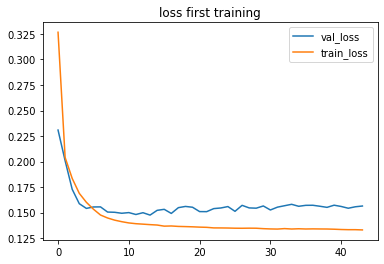

In [9]:
plt.plot(history.history['val_loss'],label='val_loss')
plt.plot(history.history['loss'],label='train_loss')
plt.title('loss first training')
plt.legend()

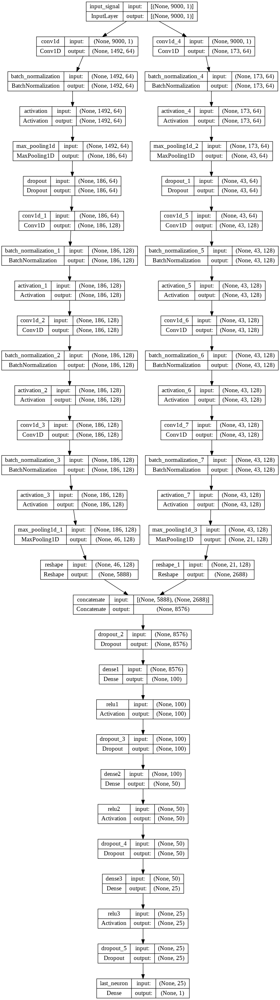

In [11]:
tf.keras.utils.plot_model(conf_model, show_shapes=True, show_layer_names=True)

In [12]:
conf_model = tf.keras.models.load_model(save_weights_at)

base_model = tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/models/2022_10_06-2202.h5',
                                   custom_objects={'F1Score':tfa.metrics.F1Score(num_classes=5,average='macro')})

# with tf.device("cpu:0"):
#   y_train_pred = base_model.predict(X_train)
#   y_valid_pred = base_model.predict(X_valid)
#   y_test_pred = base_model.predict(X_test)

with tf.device('cpu:0'): #prediction on cpu because gpu is full TODO garbage collector for gpu
  predtrain = base_model.predict(X_train)
  conf_prediction_train = conf_model.predict(X_train)
  predvalid = base_model.predict(X_valid)
  conf_prediction_valid = conf_model.predict(X_valid)
  predtest = base_model.predict(X_test)
  conf_prediction_test = conf_model.predict(X_test)

predtest_df = pd.DataFrame(y_test_pred, columns= class_names)
predtest_df['y_cap'] = y_test_pred.argmax(axis=1)
predtest_df['y'] = y_test.argmax(axis=1) #argmax because y_train is one hot encoded
predtest_df['TCP'] = y_tcp_test




# #test
# conf_prediction_test = conf_model.predict(X_test)
# #fare predizione sul train e vedere se hanno lo stesso andamento corretti e non
# conf_prediction_test = pd.DataFrame(conf_prediction_test)
# #prediction on test set with original model already done
# predtest_df = pred
# predtest_df['confidence2'] = conf_prediction_test

# #choosing correct and incorrect by treshold
# # conf_correct = conf_df1[conf_df1>0.5].dropna()
# # conf_uncorrect = conf_df1[conf_df1<=0.5].dropna()

# #choosing correct and incorrect looking at the original model prediction
# conf_correct_test = predtest_df.loc[predtest_df["y_cap"] == predtest_df["y"]]
# conf_uncorrect_test = predtest_df.loc[predtest_df["y_cap"] != predtest_df["y"]]


607/607 [==============================] - 24s 40ms/step


NameError: ignored

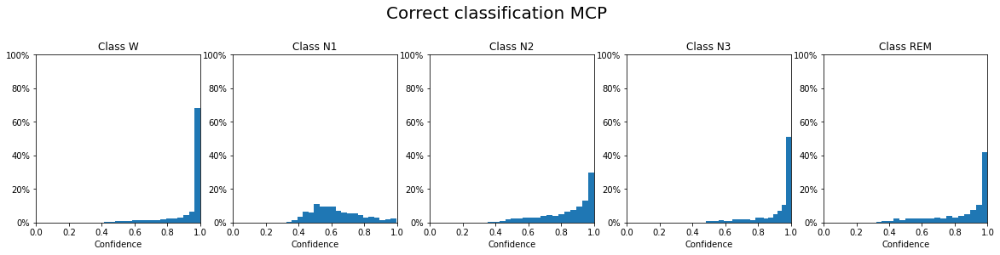

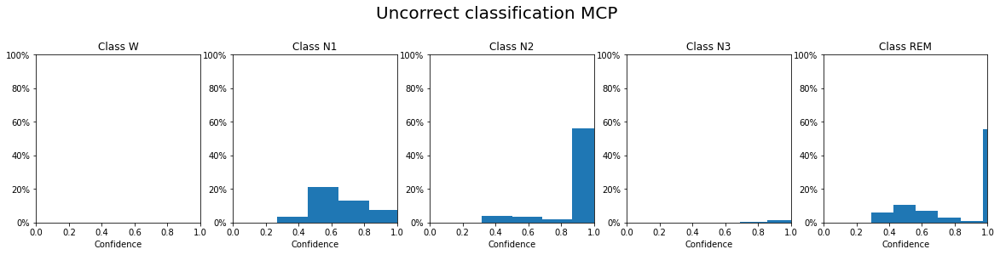

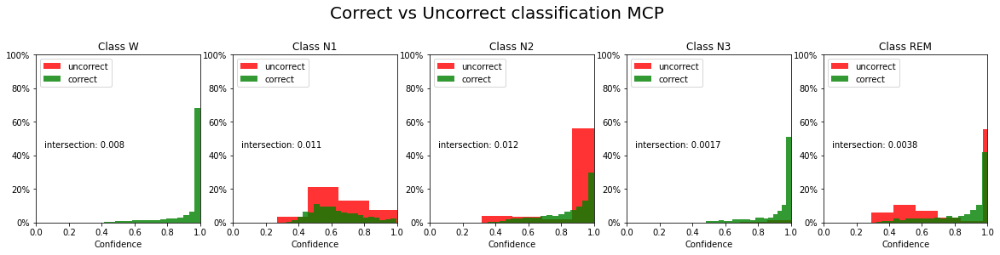

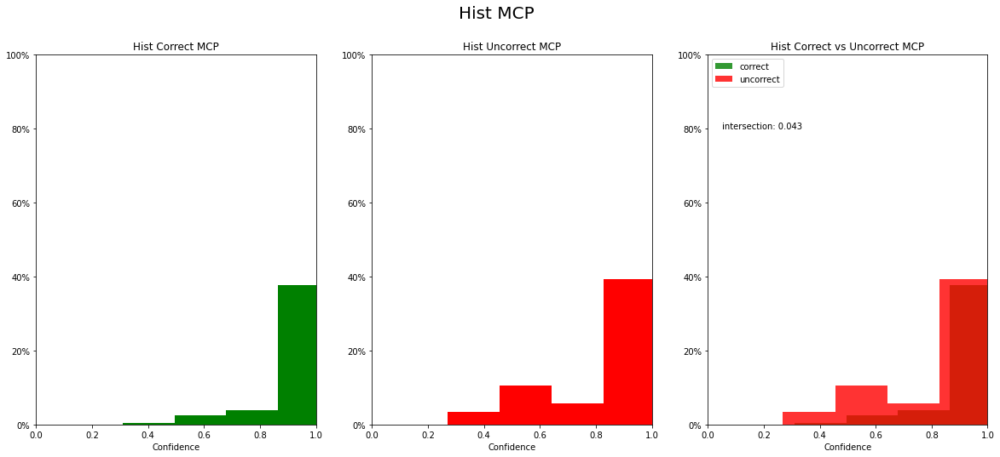

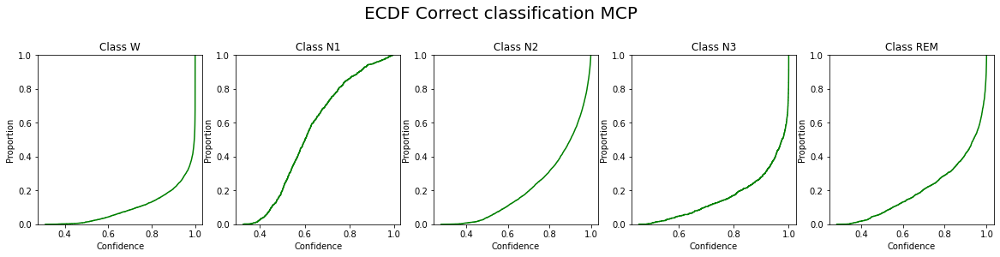

...

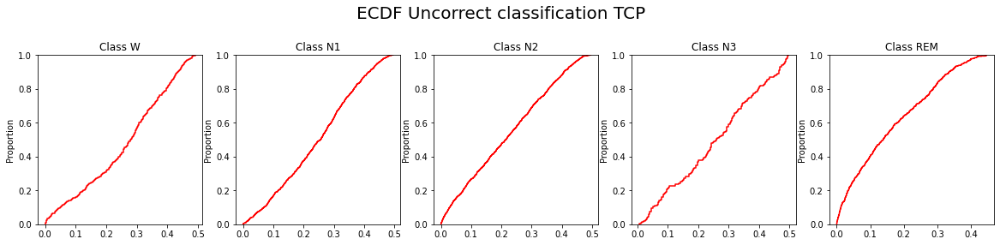

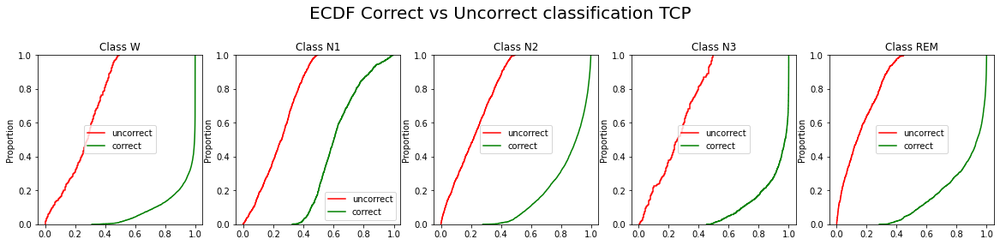

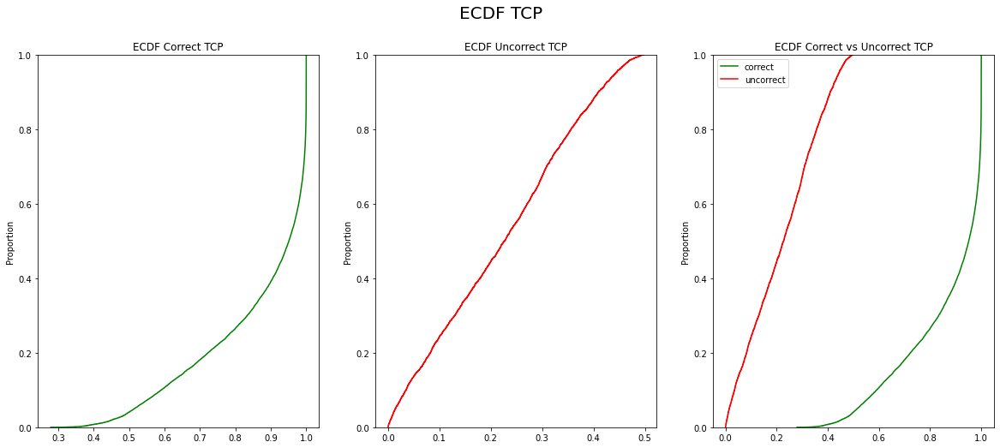

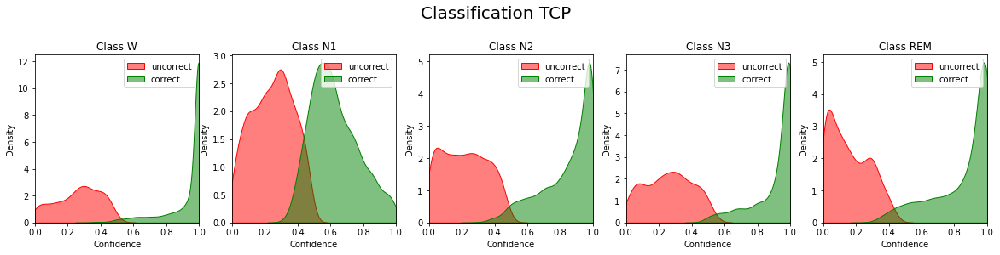

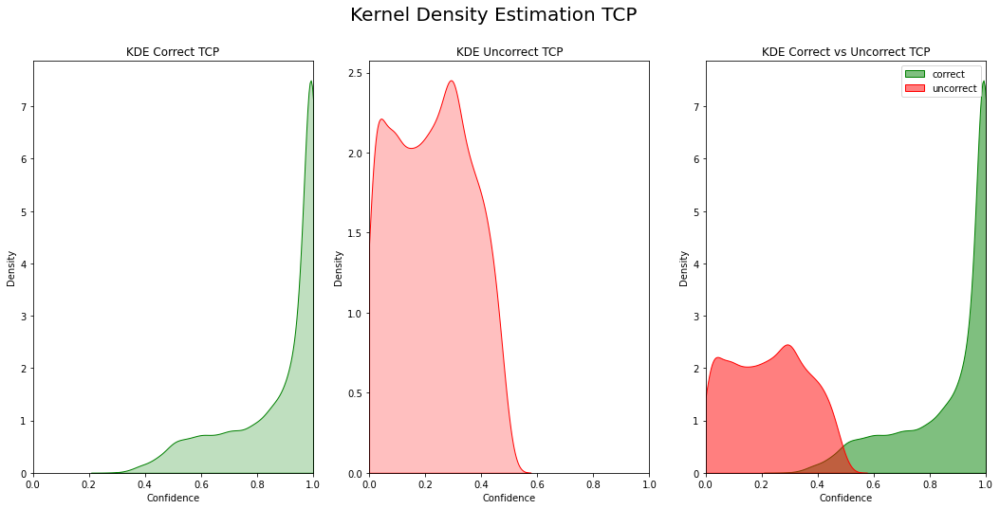

In [14]:
correct_test = predtest_df.loc[predtest_df['y_cap'] == predtest_df['y']]
notcorrect_test = predtest_df.loc[predtest_df['y_cap'] != predtest_df['y']]

histMCP(correct_test, notcorrect_test, class_names)
ecdfMCP(correct_test, notcorrect_test, class_names)
kdeMCP(correct_test, notcorrect_test, class_names)

#idal tcp
histTCP(correct_test, notcorrect_test, class_names)
ecdfTCP(correct_test, notcorrect_test, class_names)
kdeTCP(correct_test, notcorrect_test, class_names)

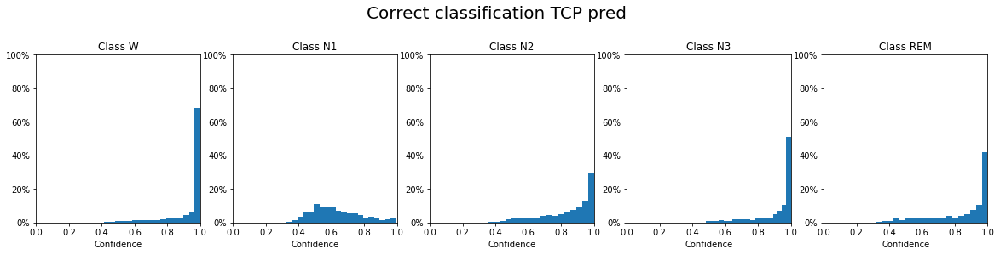

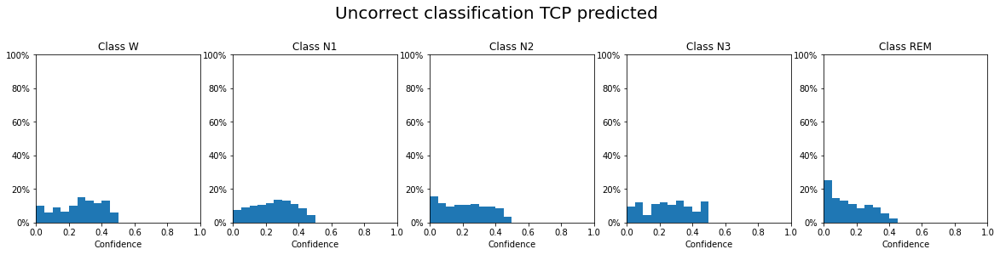

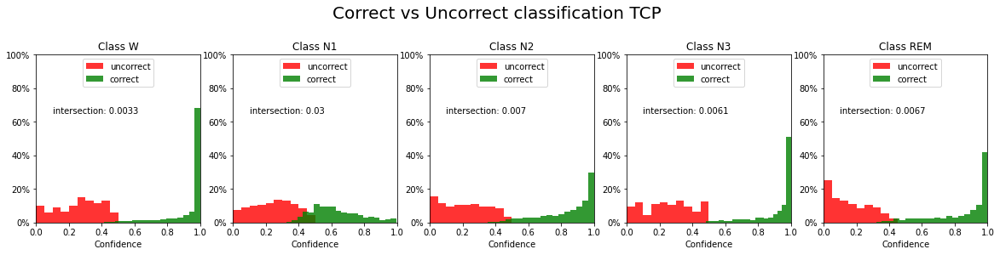

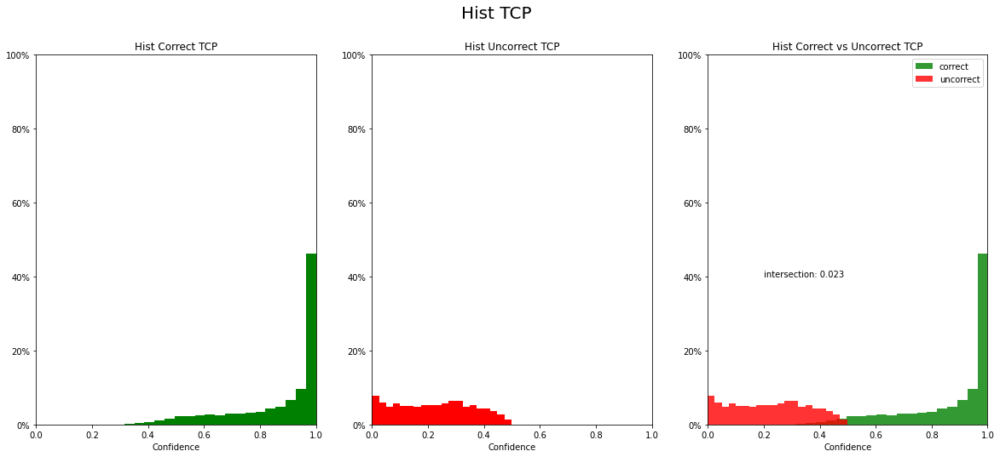

In [18]:
predtest_df['TCP_cap'] = conf_prediction_test
# predtest_df['TCP_error'] = abs(predtest_df['TCP']-predtest_df['TCP_cap'])
tcp_correct_test = predtest_df.loc[predtest_df['y_cap'] == predtest_df['y']]
tcp_notcorrect_test = predtest_df.loc[predtest_df['y_cap'] != predtest_df['y']]
histTCP_pred(correct_test, notcorrect_test, class_names)

In [6]:
#unfreeze all
for i in range(len(conf_model.layers)): #+1, because starts from 0
  conf_model.layers[i].trainable = True

for i in range(len(conf_model.layers)):
  print(conf_model.layers[i],'--- trainable --->',conf_model.layers[i].trainable)

opt = tf.keras.optimizers.Adam(learning_rate=lr, epsilon= 1e-8)
# opt = tf.keras.optimizers.Adamax(learning_rate=lr, epsilon= 1e-8)
loss = tf.keras.losses.mae
# loss='categorical_crossentropy',

conf_model.compile(
                optimizer=opt,
                loss=loss,
                metrics=['mse','mae']
                   )

class Metrics(tf.keras.callbacks.Callback):
    def __init__(self,validation_data,y_valid) -> None:
       self.validation_data = validation_data
       self.y_valid = y_valid

    def on_train_begin(self, logs={}):
        self._data = []

    def on_epoch_end(self, batch, logs={}):
        # x_test, y_test = self.validation_data[0], self.validation_data[1]
        y_predict = np.asarray(model.predict(self.validation_data))

        true = np.argmax(y_valid, axis=1)
        pred = np.argmax(y_predict, axis=1)
        
        cm = confusion_matrix(true, pred)
        cmf = cm.astype('float')
        # cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] 
        self._data.append({'cm':cm })

        print()
        print(cm.diagonal()/cm.sum(axis=1))
        print()
        print(np.around(cm, 2))
        print()
        # print(np.around(cm/np.sum(cm, axis=1),2))
        # print()
        return

    def get_data(self):
        return self._data

# metrics = Metrics(valid,y_valid) #with the prefetcher
# metrics = Metrics(valid,y_conf_valid)

# tf.keras.utils.plot_model(conf_model, show_shapes=True, show_layer_names=True)

log_dir = '/content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/'
log_directory = log_dir +'lr='+str(lr)+'_'+ datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard = tf.keras.callbacks.TensorBoard(log_dir=log_directory,
                                            histogram_freq=10,
                                            write_graph=True,
                                            write_grads=False,
                                            write_images=False,
                                            embeddings_freq=0,
                                            embeddings_layer_names=None,
                                            embeddings_metadata=None)

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                              min_delta=0.0001, 
                                              patience=patience,
                                              verbose=1,
                                              mode='min')
def schedule(epoch, lr):
    decay = 0.00009
    if epoch < 10:
        return lr
    elif epoch > 50: #and epoch < 50:
      return lr
    # elif epoch > 80 and epoch < 100:
    #   return lr
    # elif epoch > 130 and epoch <150:
    #   return lr
    # elif epoch > 180:
    #   return lr                  
    else:
        return lr * tf.math.exp(-0.1)

scheduler = tf.keras.callbacks.LearningRateScheduler(schedule, verbose=1)
#if .h5 string is deleted at the end it will save in .model format                                                  
save_weights_at = log_dir +'models/'+ datetime.datetime.now().strftime("%Y_%m_%d-%H%M")+'.h5'

checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath=save_weights_at,
                                          monitor='val_loss',
                                          mode='min',
                                          verbose=1,
                                          save_best_only=True,
                                          save_weights_only=False)
    # prefetcher
# history = conf_model.fit(
#                     train,
#                     batch_size=500,
#                     epochs=epochs,
#                     verbose=1,
#                     validation_data=valid,
#                     callbacks=[tensorboard, early_stopping, checkpoint])

history = conf_model.fit(
                    X_train,y_conf_train,
                    batch_size=500,
                    epochs=epochs,
                    verbose=1,
                    validation_data=(X_valid, y_conf_valid),
                    callbacks=[tensorboard, early_stopping, checkpoint, scheduler]
                    )

<keras.engine.input_layer.InputLayer object at 0x7f78d01f4790> --- trainable ---> True
<keras.layers.convolutional.conv1d.Conv1D object at 0x7f78d028e510> --- trainable ---> True
<keras.layers.convolutional.conv1d.Conv1D object at 0x7f7878078790> --- trainable ---> True
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7f78d028ea90> --- trainable ---> True
<keras.layers.normalization.batch_normalization.BatchNormalization object at 0x7f78780749d0> --- trainable ---> True
<keras.layers.core.activation.Activation object at 0x7f787812c110> --- trainable ---> True
<keras.layers.core.activation.Activation object at 0x7f7878074750> --- trainable ---> True
<keras.layers.pooling.max_pooling1d.MaxPooling1D object at 0x7f787818b490> --- trainable ---> True
<keras.layers.pooling.max_pooling1d.MaxPooling1D object at 0x7f78781d6b50> --- trainable ---> True
<keras.layers.regularization.dropout.Dropout object at 0x7f787828e7d0> --- trainable ---> True
<keras.layers.regula

Text(0.5, 1.0, 'fine tuning')

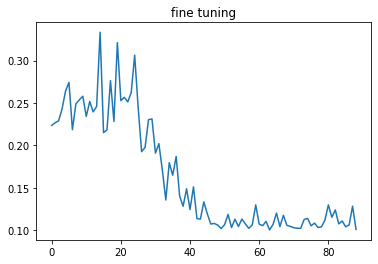

In [7]:
plt.plot(history.history['val_loss'])
plt.title('fine tuning')

In [13]:
with tf.device("cpu:0"):
  y_test_pred = base_model.predict(X_test,batch_size=500)

y_conf_test = []

for i in range(len(y_test)):
  y_conf_test.append(y_test_pred[i][y_test[i].argmax(axis=0)])
y_conf_test = np.asarray(y_conf_test, dtype=np.float32)

predtest_df = pd.DataFrame(predtest, columns= class_names)
predtest_df['y_cap'] = predtest.argmax(axis=1)
predtest_df['y'] = y_test.argmax(axis=1) #argmax because y_train is one hot encoded
predtest_df['TCP'] = y_conf_test
predtest_df['TCP_cap'] = conf_prediction_test
# predtrain_df['TCP_absolute_error'] = abs(predtrain_df['TCP']-predtrain_df['TCP_cap'])

39/39 [==============================] - 19s 492ms/step


In [14]:
predtest_df

,W,N1,N2,N3,REM,y_cap,y,TCP,TCP_cap
0,0.000004,0.000032,1.671361e-02,9.832504e-01,2.297559e-09,3,3,0.983250,0.976243
1,0.000011,0.000003,2.403510e-03,9.975832e-01,4.592966e-10,3,3,0.997583,0.998409
2,0.997120,0.002821,3.993255e-05,2.328573e-10,1.908683e-05,0,0,0.997120,0.999249
3,0.999988,0.000011,1.021881e-07,7.632142e-13,3.415298e-09,0,0,0.999988,0.999480
4,0.999665,0.000115,1.903068e-04,2.937250e-05,7.070148e-12,0,0,0.999665,0.998945
...,...,...,...,...,...,...,...,...,...
19415,0.653312,0.337551,4.967613e-03,3.949192e-08,4.169178e-03,0,0,0.653312,0.599599
19416,0.139044,0.638421,2.180164e-01,5.592511e-05,4.462797e-03,1,1,0.638421,0.433295
19417,0.996255,0.003088,1.832259e-05,1.101723e-09,6.384679e-04,0,0,0.996255,0.993777
19418,0.000038,0.000187,9.989364e-01,7.962206e-04,4.309174e-05,2,2,0.998936,1.000770


IndexError: ignored

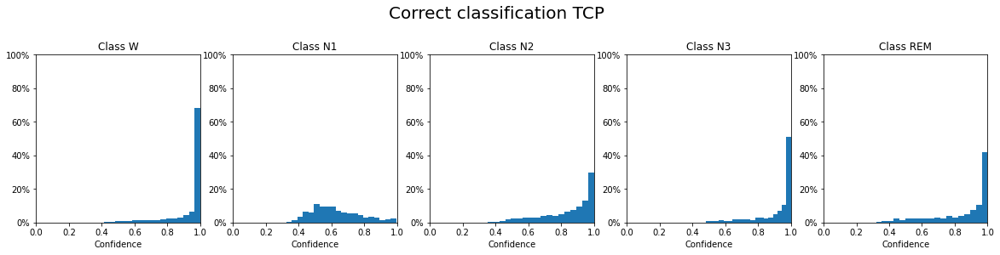

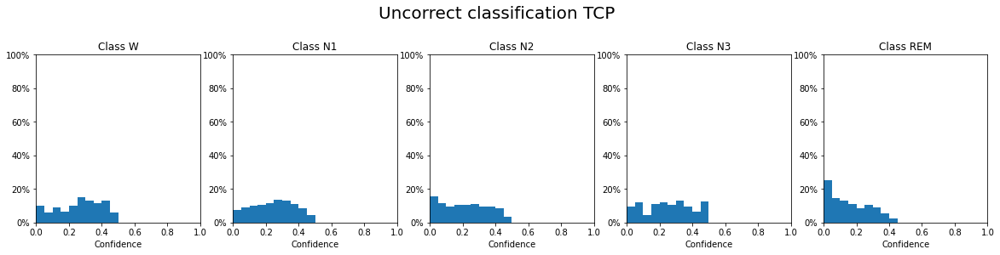

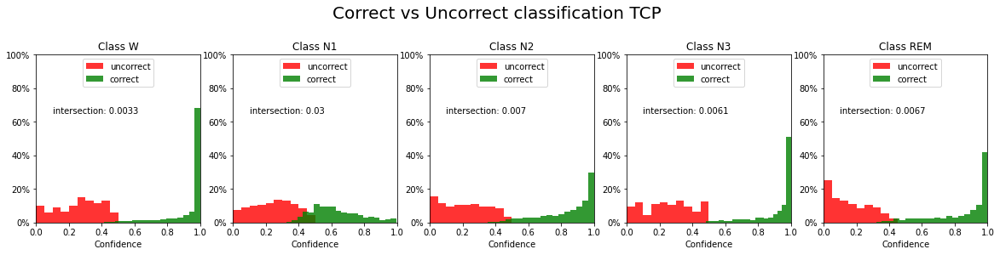

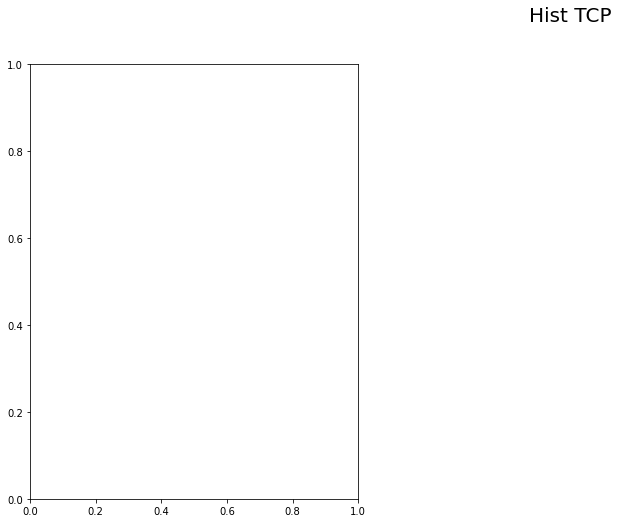

In [18]:
#choosing correct and incorrect looking at the original model prediction
conf_correct_test = predtest_df.loc[predtest_df["y_cap"] == predtest_df["y"]]
conf_notcorrect_test = predtest_df.loc[predtest_df["y_cap"] != predtest_df["y"]]

#TCP ideal
histTCP(conf_correct_test, conf_notcorrect_test, class_names)
ecdfTCP(conf_correct_test, conf_notcorrect_test, class_names)
kdeTCP(conf_correct_test, conf_notcorrect_test, class_names)

In [ ]:
predtrain_df = pd.DataFrame(predtrain, columns= class_names)
predtrain_df['y_cap'] = predtrain.argmax(axis=1)
predtrain_df['y'] = y_train.argmax(axis=1) #argmax because y_train is one hot encoded
predtrain_df['TCP'] = y_conf_train
predtrain_df['TCP_cap'] = conf_prediction_train
# predtrain_df['TCP_absolute_error'] = abs(predtrain_df['TCP']-predtrain_df['TCP_cap'])

In [ ]:
predtrain_df

,W,N1,N2,N3,REM,y_cap,y,TCP,TCP_cap
0,0.878748,0.099413,0.001502,3.524248e-07,0.020337,0,0,0.878748,0.657928
1,0.001144,0.043156,0.867686,8.446156e-02,0.003552,2,2,0.867686,0.699918
2,0.060300,0.073677,0.555199,3.107392e-01,0.000084,2,2,0.555199,0.524888
3,0.307136,0.278615,0.226500,2.574384e-05,0.187724,0,1,0.278615,0.248495
4,0.136531,0.506333,0.351207,4.998566e-03,0.000931,1,2,0.351207,0.564699
...,...,...,...,...,...,...,...,...,...
155354,0.136248,0.396268,0.028092,6.672140e-07,0.439391,4,4,0.439391,0.656807
155355,0.005113,0.033689,0.763434,5.851632e-03,0.191912,2,2,0.763434,0.904932
155356,0.001078,0.006439,0.005005,4.737220e-07,0.987477,4,4,0.987477,0.883881
155357,0.975772,0.000233,0.000311,2.368137e-02,0.000003,0,0,0.975772,1.011771


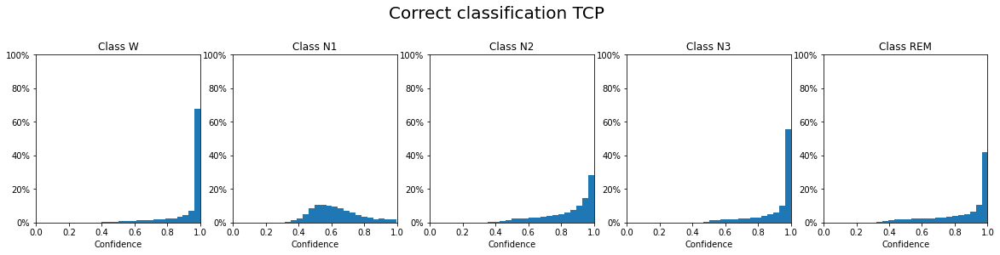

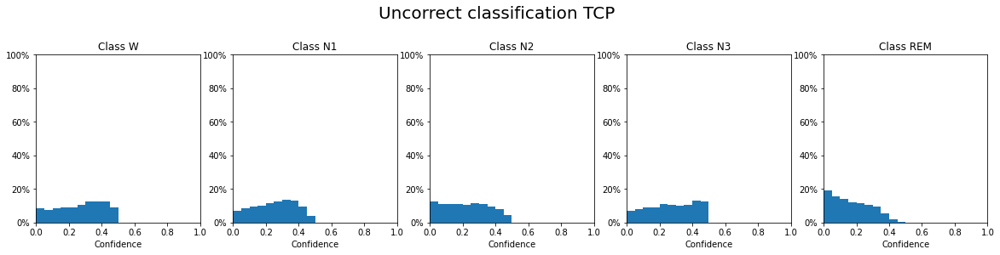

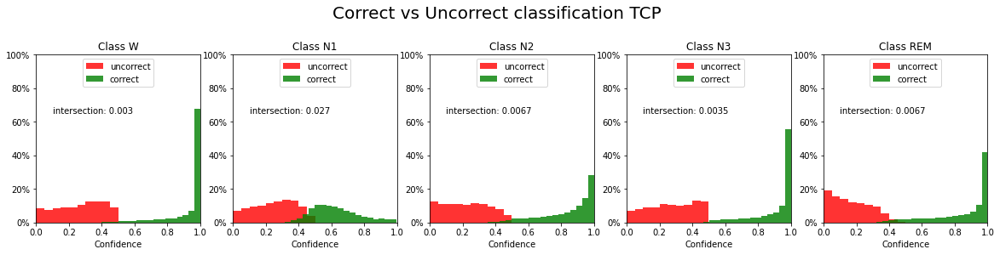

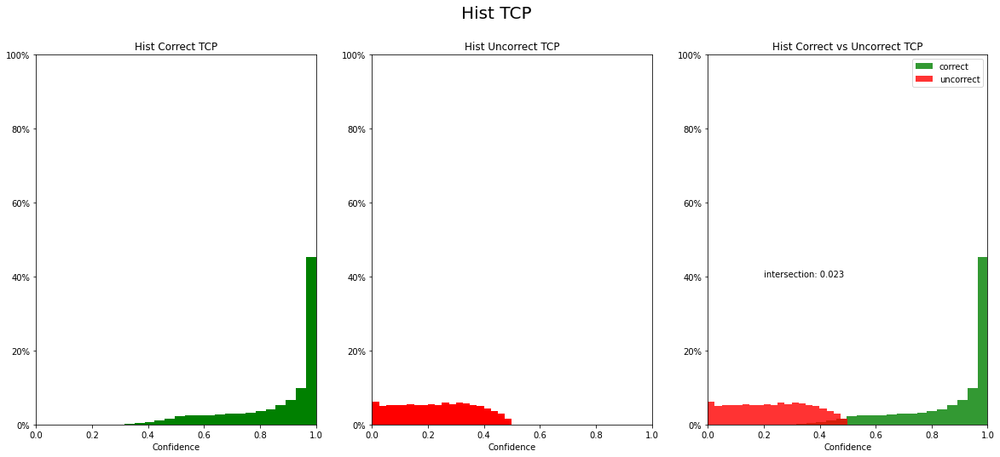

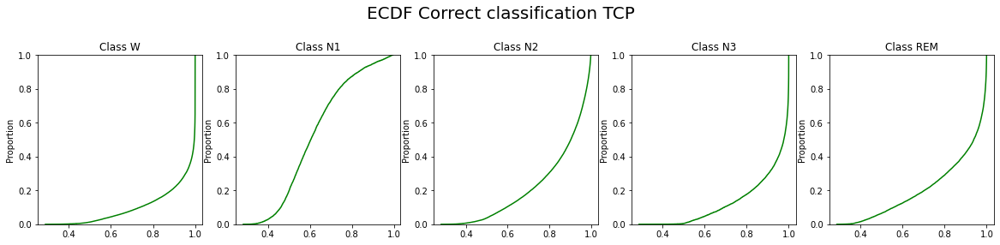

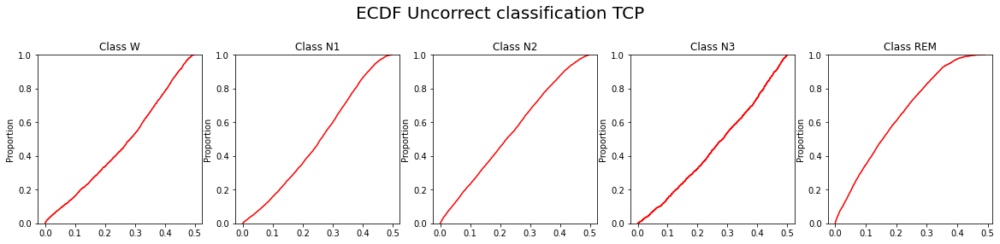

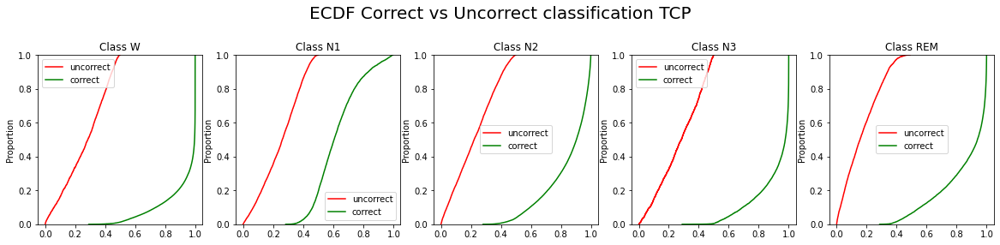

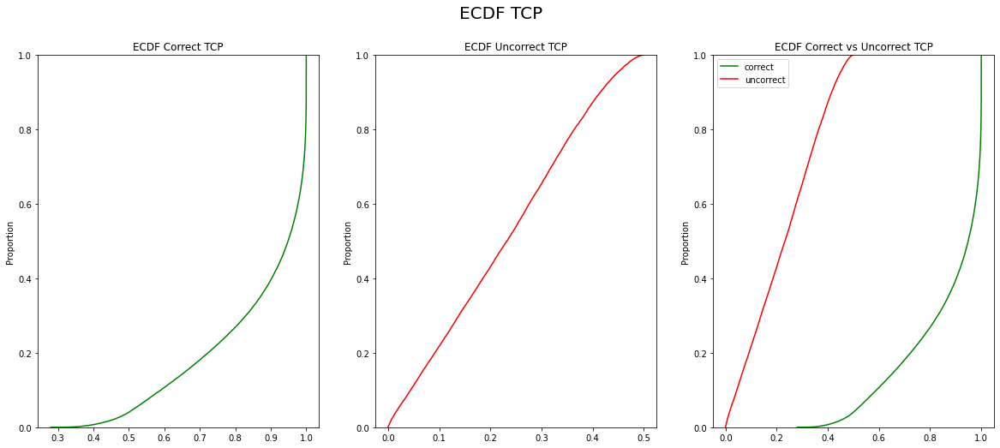

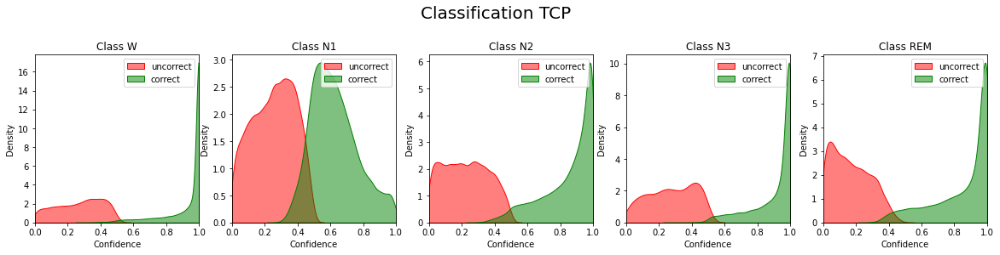

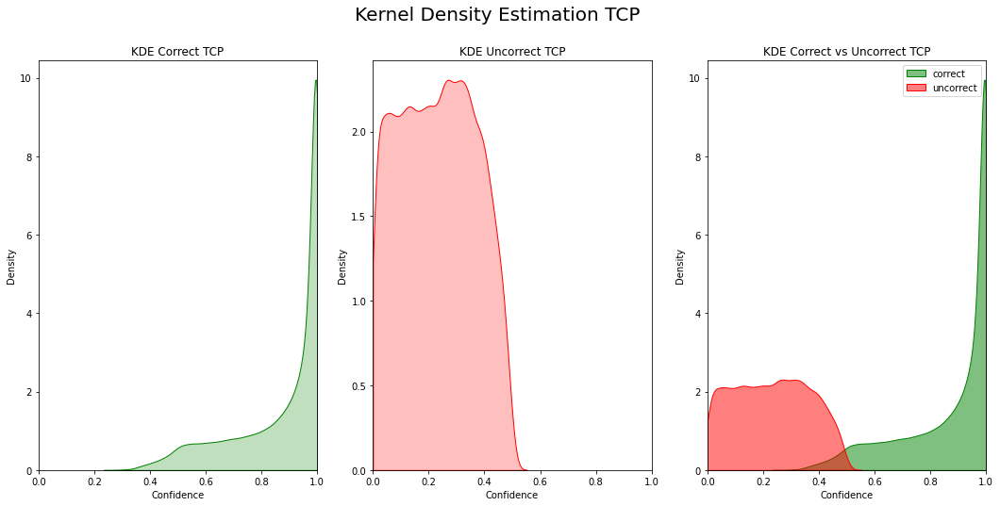

In [ ]:
#choosing correct and incorrect looking at the original model prediction
conf_correct_train = predtrain_df.loc[predtrain_df["y_cap"] == predtrain_df["y"]]
conf_notcorrect_train = predtrain_df.loc[predtrain_df["y_cap"] != predtrain_df["y"]]

#TCP ideal
histTCP(conf_correct_train, conf_notcorrect_train, class_names)
ecdfTCP(conf_correct_train, conf_notcorrect_train, class_names)
kdeTCP(conf_correct_train, conf_notcorrect_train, class_names)

#TCP predicted
predtrain_df['TCP_cap'] = conf_prediction_train
conf_correct_train = predtrain_df.loc[predtrain_df["y_cap"] == predtrain_df["y"]]
conf_notcorrect_train = predtrain_df.loc[predtrain_df["y_cap"] != predtrain_df["y"]]

histTCP(conf_correct_train, conf_notcorrect_train, class_names)
ecdfTCP(conf_correct_train, conf_notcorrect_train, class_names)
kdeTCP(conf_correct_train, conf_notcorrect_train, class_names)

In [ ]:
predvalid_df = pd.DataFrame(predvalid, columns= class_names)
predvalid_df['y_cap'] = predvalid.argmax(axis=1)
predvalid_df['y'] = y_valid.argmax(axis=1) #argmax because y_valid is one hot encoded
predvalid_df['TCP'] = y_conf_valid
predvalid_df['TCP_cap'] = conf_prediction_valid
# predvalid_df['TCP_absolute_error'] = abs(predvalid_df['TCP']-predvalid_df['TCP_cap'])

NameError: ignored

[array([[-3.0639818 , -3.6864312 , -3.0237837 , -3.0403397 , -3.032864  ],
       [-3.0363998 ,  0.48352438, -3.0314503 , -3.0701606 , -0.03675262],
       [-3.043016  ,  0.54299426, -3.0498576 , -3.0375175 ,  3.0049272 ],
       ...,
       [-3.0373323 , -2.1388986 , -3.0609624 , -3.0364182 , -0.00745401],
       [-3.0426505 , -3.0477395 , -3.0521336 , -3.0640402 , -3.0630744 ],
       [-3.0512147 , -2.1931674 , -3.063661  , -3.0532572 , -3.0472083 ]],
      dtype=float32), array([-3.0418797, -3.8776722, -3.0445752, -3.05074  , -3.0396116],
      dtype=float32)]


(array([[0.000e+00, 8.429e+03, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
         0.000e+00, 0.000e+00, 0.000e+00, 1.470e+02],
        [1.242e+03, 1.794e+03, 2.690e+02, 5.960e+02, 6.050e+02, 6.790e+02,
         4.730e+02, 1.710e+02, 1.230e+02, 2.624e+03],
        [0.000e+00, 7.697e+03, 0.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
         0.000e+00, 0.000e+00, 0.000e+00, 8.780e+02],
        [0.000e+00, 8.156e+03, 6.000e+00, 1.000e+00, 0.000e+00, 4.130e+02,
         0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00],
        [0.000e+00, 6.486e+03, 0.000e+00, 0.000e+00, 0.000e+00, 1.380e+02,
         0.000e+00, 0.000e+00, 1.000e+00, 1.951e+03]]),
 array([-4.3073306 , -3.5674245 , -2.8275185 , -2.0876126 , -1.3477066 ,
        -0.6078005 ,  0.13210554,  0.87201154,  1.6119176 ,  2.3518236 ,
         3.0917296 ], dtype=float32),
 <a list of 5 Lists of Patches objects>)

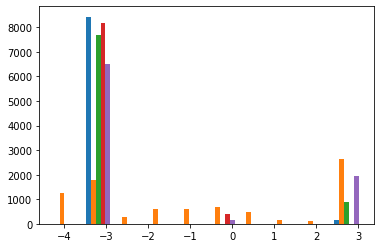

In [ ]:
level=-4
print(conf_model.layers[level])
print(conf_model.layers[level].get_weights())
plt.hist(conf_model.layers[level].get_weights()[0])

In [ ]:
data1=[]
i=0
row = conf_correct.values[0]
# for i,row in enumerate(conf_correct.values):
data1.append(row[conf_correct.iloc[i,-2]])

IndexError: ignored

In [21]:

# conf_correct = conf_correct_test
# conf_uncorrect = conf_notcorrect_test

n_bins=20
#correct
fig1 = plt.figure(figsize=(20,8))
fig1.suptitle('Correct classification TCP pred', fontsize=20)
for i,name in enumerate(class_names):
  tmp = conf_correct.loc[conf_correct["y"]==i] #select the correct from class i
  data01 = tmp.iloc[:,-1].to_numpy()

  plt.subplot(2,5,i+1)
  plt.hist(data01, 
            weights= np.ones(len(data01))/len(data01), # weighting the data like 1/n
            bins=n_bins)
  
  plt.title(f"Class {name}")
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))

#uncorrect
#TODO why in the graphs this part has very little bins? idk
fig2 = plt.figure(figsize=(20,8))
fig2.suptitle('Uncorrect classification TCP predicted', fontsize=20)
for i,name in enumerate(class_names):
  tmp = conf_uncorrect.loc[conf_uncorrect["y"]==i] #select the correct from class i
  data02 = tmp.iloc[:,-1].to_numpy()

  plt.subplot(2,5,i+1)
  plt.hist(data02, range=(0,1),
            weights= np.ones(len(data02))/len(data02), # weighting the data like 1/n
            bins=n_bins)
  
  plt.title(f"Class {name}")
  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
  
#mixed
fig3 = plt.figure(figsize=(20,8))
fig3.suptitle('Correct vs Uncorrect classification TCP', fontsize=20)
for i,name in enumerate(class_names):
  tmpu = conf_uncorrect.loc[conf_uncorrect["y"]==i] #see before
  datau = tmpu.iloc[:,-1].to_numpy()

  tmpc = conf_correct.loc[conf_correct["y"]==i] #see before
  datac = tmpc.iloc[:,-1].to_numpy()

  plt.subplot(2,5,i+1)
  histu, _, _ = plt.hist(datau, range=(0,1),
            weights= np.ones(len(datau))/len(datau), 
            bins=n_bins, alpha=0.8, color='red', label='uncorrect')
  histc, _, _ = plt.hist(datac,
            weights= np.ones(len(datac))/len(datac), 
            bins=n_bins, alpha=0.8, color='green', label='correct')
  plt.title(f"Class {name}")
  intersection = histogram_intersection(histc,histu,n_bins)
  plt.annotate(f'intersection: {intersection:.2}',xy=(0.1, 0.65))

  plt.gca().set_xlim(0,1)
  plt.gca().set_ylim(0,1)
  plt.gca().set_xlabel("Confidence")
  plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
  plt.legend(loc='upper center')

#total (not for class)
fig4 = plt.figure(figsize=(20,8))
fig4.suptitle('Hist TCP', fontsize=20)

plt.subplot(1,3,1)
data1=[]
for i,row in enumerate(conf_correct.values):
  data1.append(conf_correct.iloc[i,-1])
  #scrolling the rows, on every i-th row, I select the column correspondent to the
# prediction done (y_cap), ie in the first row the y_cap is 5 so I select the 5th
# element of the row

plt.hist(data1,
            weights= np.ones(len(data1))/len(data1), # weighting the data like 1/n
            bins=n_bins, color='green')
plt.title(f'Hist Correct TCP')
plt.gca().set_xlim(0,1)
plt.gca().set_ylim(0,1)
plt.gca().set_xlabel("Confidence")
plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))


plt.subplot(1,3,2)
data2=[]
for i,row in enumerate(conf_uncorrect.values):
  data2.append(conf_uncorrect.iloc[i,-1])
#see before

plt.hist(data2,
            weights= np.ones(len(data2))/len(data2), # weighting the data like 1/n
            bins=n_bins, color='red')
plt.title(f'Hist Uncorrect TCP')
plt.gca().set_xlim(0,1)
plt.gca().set_ylim(0,1)
plt.gca().set_xlabel("Confidence")
plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))


plt.subplot(1,3,3)
histc, _, _ = plt.hist(data1,
            weights= np.ones(len(data1))/len(data1), 
            bins=n_bins, alpha=0.8, color='green', label='correct')
histu, _, _ = plt.hist(data2,
            weights= np.ones(len(data2))/len(data2), 
            bins=n_bins, alpha=0.8, color='red', label='uncorrect')
intersection = histogram_intersection(histc,histu,n_bins)
plt.annotate(f'intersection: {intersection:.2}',xy=(0.2, 0.4))

plt.title(f'Hist Correct vs Uncorrect TCP')
plt.gca().set_xlim(0,1)
plt.gca().set_ylim(0,1)
plt.gca().set_xlabel("Confidence")
plt.gca().yaxis.set_major_formatter(PercentFormatter(1, decimals=0))
plt.legend()


NameError: ignored

<Figure size 1440x576 with 0 Axes>

In [ ]:
#lenght of the trainable part
length_trainable = 35

# print(conf_model.layers[1].get_weights())
for i,layer in enumerate(base_model.layers):
  # conf_model.set_weights(base_model.layers[:length_trainable].get_weights()) #if the model is loaded
  print('layer to set1',layer)
  print('layer to set2',conf_model.layers[i])
  print(layer.get_weights())
  print('pre conf',layer)
  print(conf_model.layers[i].get_weights())
  conf_model.layers[i].set_weights(layer.get_weights())
  print('post conf',layer)
  print(conf_model.layers[i].get_weights())
  
# print(conf_model.layers[1].get_weights())

layer to set1 <keras.engine.input_layer.InputLayer object at 0x7fae2e321150>
layer to set2 <keras.engine.input_layer.InputLayer object at 0x7fad87982450>
[]
pre conf <keras.engine.input_layer.InputLayer object at 0x7fae2e321150>
[]
post conf <keras.engine.input_layer.InputLayer object at 0x7fae2e321150>
[]
layer to set1 <keras.layers.convolutional.Conv1D object at 0x7fad87982250>
layer to set2 <keras.layers.convolutional.Conv1D object at 0x7fae1676e6d0>
[array([[[ 0.0038756 ,  0.00504417, -0.00538048, ..., -0.0046073 ,
          0.0062586 ,  0.03051326]],

       [[-0.01437644, -0.02576757, -0.03158403, ..., -0.02367917,
         -0.00983497,  0.00388606]],

       [[ 0.04065126, -0.020512  , -0.01799397, ..., -0.00779608,
          0.01275733,  0.00061494]],

       ...,

       [[ 0.0008286 ,  0.03790786,  0.00359656, ..., -0.01235809,
          0.0049617 ,  0.01501616]],

       [[-0.01185015, -0.01215264, -0.01118881, ...,  0.01185984,
         -0.01549701, -0.00442237]],

       [

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard  --logdir /content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug

Reusing TensorBoard on port 6006 (pid 924), started 0:01:00 ago. (Use '!kill 924' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# !pip install tensorflow_addons
import tensorflow_addons as tfa
model = model = tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/basfit_tfdataset_compl_nomix_aug/models/2022_10_03-1233.h5',
                                           custom_objects={'F1Score':tfa.metrics.F1Score(num_classes=5,average='macro')})

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
y_pred = model.predict(X1[:100])

In [ ]:
from sklearn.metrics import classification_report
import numpy as np
print(classification_report(np.argmax(y1[:100],axis=1), np.argmax(y_pred,axis=1)))

from sklearn.metrics import confusion_matrix
matrix = confusion_matrix(np.argmax(y1[:100],axis=1), np.argmax(y_pred,axis=1))
matrix.diagonal()/matrix.sum(axis=1)

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        60
           1       0.04      1.00      0.08         4
           2       0.00      0.00      0.00        14
           3       0.00      0.00      0.00        22

    accuracy                           0.04       100
   macro avg       0.01      0.25      0.02       100
weighted avg       0.00      0.04      0.00       100



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


array([0., 1., 0., 0.])

In [ ]:
y1[:100].argmax(axis=1)

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3])

In [ ]:
#test for interleave again
%cd ~

/root


In [ ]:
os.mkdir('dataset')

In [ ]:
%cd /root/dataset

/root/dataset


In [ ]:
prova = X[:1000]

In [ ]:
os.mkdir( '/root/dataset2/')

In [ ]:
path = '/root/dataset2/'
y1 = np.array(y,dtype='object')
for i in range(10):
  tupla = (X[100*i:100*(i+1)],y1[100*i:100*(i+1)])
  print(y1[100*i:100*(i+1)].shape)
  with open(f'part_{i}','wb') as f:
    print(i)
    np.save(f, 
            tupla
    )

(100, 5)
0


/usr/local/lib/python3.7/dist-packages/numpy/lib/npyio.py:528: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


ValueError: ignored

In [ ]:
for i in range(10):
  tupla = (X[100*i:100*(i+1)],y[100*i:100*(i+1)])

In [ ]:
tupla[1].shape

(100, 5)

In [ ]:
y[100*i:100*(i+1)].argmax(axis=1)

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3])

In [ ]:
a=np.load('/root/dataset2/part_1')

FileNotFoundError: ignored

In [ ]:
path = '/root/dataset2/'
names = os.listdir(path)
filepaths=[]
for name in names:
  filepaths.append(path+name)

In [ ]:
dataset_prova = tf.data.Dataset.list_files(filepaths)
dataset_prova_inter = dataset_prova.interleave(lambda x: tf.data.Dataset.from_tensor_slices((x,1)), cycle_length=2)
tf.data.Dataset.

ValueError: ignored

In [ ]:
# %cd /content/drive/MyDrive/prove_DSNL_keras/download_dataset/data
# path = './10_fold_data'
# if os.path.exists(path) is False:
#     os.mkdir(path)

# #WARNING TOO MUCH SPACE REQUIRED, 18G EACH FOLD
# for i in range(k):
#   X_train, y_train, X_valid, y_valid, X_test, y_test = dp.kfold(Xaug, yaug, k, i)
#   with open( join(path, str(i)+'.npz'), 'wb') as f:
#     np.savez(
#         f,
#         X_train, y_train, X_valid, y_valid, X_test, y_test,
#         X, y, Xaug, yaug
#     )

/content/drive/MyDrive/prove_DSNL_keras/download_dataset/data


In [ ]:
# #creation partition for data loader
# partX_train = {'train':idx_train}
# partX_valid = {'valid':idx_valid}

# #labels
# party_train = {}
# for i in range(len(idx_train)):
#   party_train[f'{idx_train[i]}'] = y[idx_train[i]].argmax()

# party_valid = {}
# for i in range(len(idx_valid)):
#   party_valid[f'{idx_valid[i]}'] = y[idx_valid[i]].argmax()

In [ ]:
import time
class DataGenerator(tf.keras.utils.Sequence):
    # 'Generates data for Keras'
    def __init__(self, list_IDs, labels, batch_size=32, dim=(9000), #n_channels=1,
                 n_classes=5, shuffle=True):
        # print('Initialization')
        self.dim = dim
        self.batch_size = batch_size
        self.labels = labels
        self.list_IDs = list_IDs
        # self.n_channels = n_channels
        self.n_classes = n_classes
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        # print('__len__')
        # 'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))

    def __getitem__(self, index):
        # print('__getitem')
        # 'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs
        list_IDs_temp = [self.list_IDs[k] for k in indexes]

        # Generate data
        X, y = self.__data_generation(list_IDs_temp)

        return X, y

    def on_epoch_end(self):
        # print('on_epoch_end')
        # 'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, list_IDs_temp):
        # print('__data_generation')
        # start = time.time()
        # 'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        # X = np.empty((self.batch_size, *self.dim, self.n_channels))
        X = np.empty((self.batch_size, self.dim))
        y = np.empty((self.batch_size), dtype=int)
        # print(list_IDs_temp)
        # print(len(list_IDs_temp))
        # Generate data
        for i, ID in enumerate(list_IDs_temp):
            # print('__data_generation ciclo for')
            # Store sample
            # X[i,] = np.load('data/' + ID + '.npy')
            # # Store class
            y[i] = self.labels[f'{list_IDs_temp[i]}']
            # X[i,:] = np.load('download_dataset/dataX.npy')[list_IDs_temp[i]]
        # y = self.labels[f'{list_IDs_temp}']
        X = np.load('download_dataset/dataX.npy')[list_IDs_temp]
        # end = time.time()
        # print("time execution ", (end-start)*10**3, ' ms')
        # print("time execution ", (end-start)*10**3, ' ms')
        return X, tf.keras.utils.to_categorical(y, num_classes=self.n_classes)

In [ ]:
list_IDs_temp=[184861, 8588, 18942, 143125, 61528, 131053, 23460, 15481, 188017, 29577, 14028, 133751, 35969, 108963, 182944, 97627, 11567, 23423, 116544, 166753, 74445, 52681, 77149, 75334, 80452, 160313, 121339, 183525, 129659, 16913, 108068, 22712]
y1 = np.empty((32), dtype=int)
y1[list_IDs_temp] = list(party_train.values())

ValueError: ignored

In [ ]:
import tensorflow_addons as tfa

params = {'dim': (9000),
          'batch_size': 64,
          'n_classes': 5,
          # 'n_channels': 1,
          'shuffle': True}

training_generator = DataGenerator(partX_train['train'], party_train, **params)
validation_generator = DataGenerator(partX_valid['valid'], party_valid, **params)
model=tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/base_fit3/models/2022_08_18-1612.h5',
                                 custom_objects={
                                                    'F1Score':tfa.metrics.F1Score(num_classes=5,average='macro'),
                                                    'CohenKappa':tfa.metrics.CohenKappa(num_classes=5),
                                                    'FBetaScore':tfa.metrics.FBetaScore(num_classes=5,average='macro')
})
model.fit(training_generator,
                    validation_data=validation_generator,
                    use_multiprocessing=True,
                    workers=6)

[146178, 2568, 14000, 66199, 73663, 28455, 126525, 35910, 3953, 61310, 61575, 94395, 52719, 78370, 130487, 48104, 87175, 93745, 170489, 156562, 23875, 39781, 4355, 117912, 48896, 15543, 37216, 108832, 3837, 119351, 110385, 63096, 117876, 367, 157276, 78675, 184204, 83421, 184767, 22210, 125844, 2000, 50576, 48590, 167980, 134567, 79376, 148328, 10870, 113517, 68767, 39554, 120601, 187784, 152671, 167484, 172587, 85817, 162206, 13581, 152567, 92046, 115859, 68148]
64


KeyboardInterrupt: ignored

In [ ]:
%cd /content/drive/MyDrive/prove_DSNL_keras
from train import *
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score
from data_prep import *
dp = DataPrep()

# confirm TensorFlow sees the GPU
from tensorflow.python.client import device_lib
assert 'GPU' in str(device_lib.list_local_devices())
if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
    print("Please install GPU version of TF")

# learn = [1e-7,2e-7,3e-7,4e-7,5e-7,6e-7,7e-7,8e-7,9e-7]
# for learning in learn:
  # print("############################## learning rate ##############################")
  # print(f"        {lr}        ")
  # print("###########################################################################")
path = './logs/basfit_compl_nomix/10_fold/'
if os.path.exists(path) is False:
    os.mkdir(path)

path = './logs/basfit_compl_nomix/10_fold/' + datetime.datetime.now().strftime("%Y_%m_%d-%H%M")
if os.path.exists(path) is False:
    os.mkdir(path)

k=10
for i in range(k):
  idx_train, idx_valid, idx_test = dp.kfold_idx(X, k, i)
  params = {'dim': (9000),
          'batch_size': 500,
          'n_classes': len(y[0]),
          'shuffle': True}

  #creation partition for data loader
  partX_train = {'train':idx_train}
  partX_valid = {'valid':idx_valid}

  #labels
  party_train = {}
  for i in range(len(idx_train)):
    party_train[f'{idx_train[i]}'] = y[idx_train[i]].argmax()

  party_valid = {}
  for i in range(len(idx_valid)):
    party_valid[f'{idx_valid[i]}'] = y[idx_valid[i]].argmax()

  training_generator = DataGenerator(partX_train['train'], party_train, **params)
  validation_generator = DataGenerator(partX_valid['valid'], party_valid, **params)

  history, model = trainer_gen(training_generator, validation_generator,
                    i,
                    epochs=500,
                    lr=9e-7, #9e-7
                    # batch=500,
                    log_dir=path,
                    patience=50,
                    weights=False
                    # model=tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/base_fit2/models/2022_07_18-0904') #0.72355 
                    # model=tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/base_fit2/models/2022_07_18-1922') #0.72141
                    )
  X_test = X[idx_test]
  y_test = y[idx_test]
  y_pred = model.predict(X_test)
  print(classification_report(np.argmax(y_test,axis=1), np.argmax(y_pred,axis=1)))

  matrix = confusion_matrix(np.argmax(y_test,axis=1), np.argmax(y_pred,axis=1))
  matrix.diagonal()/matrix.sum(axis=1)
  print("############################## accuracy ##############################")
  print(f"        {accuracy_score(y_test, y_pred)}        ")
  print("###########################################################################")

  print("############################## accuracy ##############################")
  print(f"        {f1_score(y_test, y_pred)}        ")
  print("###########################################################################")
  with open(join(path,'history_'+str(i)+'.bin'),'wb') as f:
      pickle.dump(history.history, f)

/content/drive/MyDrive/prove_DSNL_keras
Default GPU Device: /device:GPU:0
Epoch 1/500
310/310 [==============================] - ETA: 0s - loss: 2.2343 - accuracy: 0.3566
Epoch 1: val_accuracy improved from -inf to 0.13642, saving model to ./logs/basfit_compl_nomix/10_fold/2022_09_27-1652models/2022_09_27-1652.h5
310/310 [==============================] - 1753s 6s/step - loss: 2.2343 - accuracy: 0.3566 - val_loss: 1.5776 - val_accuracy: 0.1364
Epoch 2/500
310/310 [==============================] - ETA: 0s - loss: 1.9276 - accuracy: 0.3948
Epoch 2: val_accuracy did not improve from 0.13642
310/310 [==============================] - 1727s 6s/step - loss: 1.9276 - accuracy: 0.3948 - val_loss: 1.5871 - val_accuracy: 0.1364
Epoch 3/500
310/310 [==============================] - ETA: 0s - loss: 1.7462 - accuracy: 0.4205
Epoch 3: val_accuracy improved from 0.13642 to 0.13658, saving model to ./logs/basfit_compl_nomix/10_fold/2022_09_27-1652models/2022_09_27-1652.h5
310/310 [==================

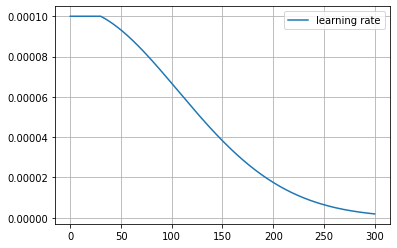

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf

def schedule(epoch, lr):
    decay = 0.00009
    if epoch < 30:
        return lr
    else:
        # return lr * tf.math.exp(-00.1)
        return lr * 1/(1+decay*epoch)
lr1 = []
lr1.append(1e-4)
for epoch in range(0,300):
  lr1.append(schedule(epoch, lr1[-1]))

plt.plot(lr1,label='learning rate')
plt.grid(True)
# plt.gca().set_ylim(0,1)
plt.legend()
# plt.yscale('log')
plt.show()
# print(lr1)

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard  --logdir /content/drive/MyDrive/prove_DSNL_keras/logs/basfit_compl_nomix

Reusing TensorBoard on port 6007 (pid 3014), started 0:57:25 ago. (Use '!kill 3014' to kill it.)

<IPython.core.display.Javascript object>

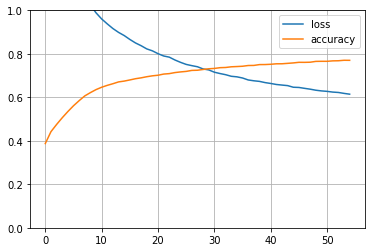

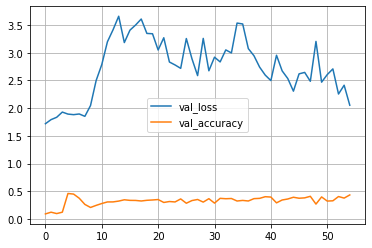

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

loss = pd.DataFrame(history.history['loss'])
accuracy = pd.DataFrame(history.history['accuracy'])

plt.plot(loss,label='loss')
plt.plot(accuracy, label='accuracy')
plt.grid(True)
plt.gca().set_ylim(0,1)
plt.legend()
plt.show()

val_loss = pd.DataFrame(history.history['val_loss'])
val_accuracy = pd.DataFrame(history.history['val_accuracy'])

plt.plot(val_loss,label='val_loss')
plt.plot(val_accuracy, label='val_accuracy')
plt.grid(True)
# plt.gca().set_ylim(0,1)
plt.legend()
plt.show()

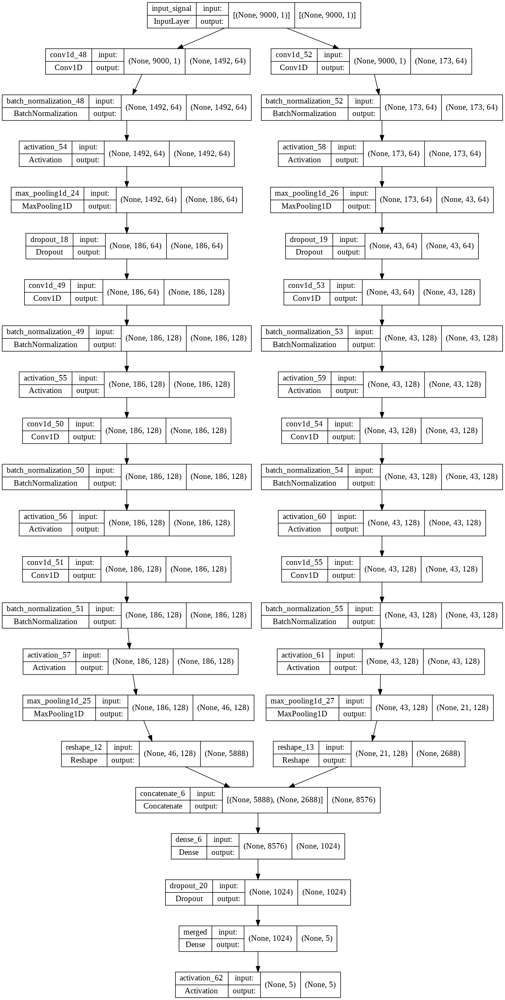

In [ ]:
#load model and test
model = tf.keras.models.load_model('/content/drive/MyDrive/prove_DSNL_keras/logs/base_fit3/models/2022_07_30-1815', compile=False) #0.74
tf.keras.utils.plot_model(model, show_shapes=True)

In [ ]:
%cd /content/drive/MyDrive/prove_DSNL_keras/
from data_prep import data_loader
X_test, y_test = data_loader(test=True)

/content/drive/MyDrive/prove_DSNL_keras


In [ ]:
y_pred = model.predict(X_test)

In [ ]:
from sklearn.metrics import classification_report
import numpy as np
print(classification_report(np.argmax(y_test,axis=1), np.argmax(y_pred,axis=1)))

from sklearn.metrics import confusion_matrix
matrix = confusion_matrix(np.argmax(y_test,axis=1), np.argmax(y_pred,axis=1))
matrix.diagonal()/matrix.sum(axis=1)

              precision    recall  f1-score   support

           0       0.97      0.94      0.95      1037
           1       0.64      0.06      0.11       521
           2       0.46      0.85      0.60       627
           3       0.11      0.85      0.20        13
           4       0.65      0.48      0.55       429

    accuracy                           0.67      2627
   macro avg       0.57      0.63      0.48      2627
weighted avg       0.73      0.67      0.63      2627

